# IP_Link_Jitter

# Step 1: Import Libraries

In [40]:
# Import Libraries

import warnings
import numpy as np
import pandas as pd
import seaborn as sns
from tqdm import notebook
import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')
warnings.filterwarnings("ignore")
from prettytable import PrettyTable 
from astropy.table import Table, Column
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report, confusion_matrix

# Step 2: Load Dataset

In [41]:
# Load Dataset

sample_data = pd.read_csv("Jitter_15min_15days_30nodes.csv")
sample_data

,Unnamed: 0,"6/12/21, 00:00","6/12/21, 00:15","6/12/21, 00:30","6/12/21, 00:45","6/12/21, 01:00","6/12/21, 01:15","6/12/21, 01:30","6/12/21, 01:45","6/12/21, 02:00",...,"20/12/21, 21:30","20/12/21, 21:45","20/12/21, 22:00","20/12/21, 22:15","20/12/21, 22:30","20/12/21, 22:45","20/12/21, 23:00","20/12/21, 23:15","20/12/21, 23:30","20/12/21, 23:45"
0,IP_LINK_1,4.78,0.83,3.37,9.78,1.27,7.17,5.89,9.42,6.49,...,9.85,5.34,2.23,4.22,3.43,8.63,9.62,1.78,0.51,8.91
1,IP_LINK_2,5.94,10.05,1.08,7.29,6.56,3.74,1.95,0.82,3.00,...,1.36,6.61,9.77,1.88,0.13,2.44,9.18,6.39,2.83,1.47
2,IP_LINK_3,6.29,4.68,9.85,2.22,9.74,4.92,5.41,1.68,6.72,...,1.36,0.89,2.33,0.36,1.36,6.33,4.52,9.51,7.86,1.77
3,IP_LINK_4,8.19,12.76,15.02,7.23,11.55,1.66,6.02,13.52,1.97,...,3.32,2.65,11.30,6.99,11.01,10.99,12.28,4.45,14.26,0.84
4,IP_LINK_5,2.57,1.90,11.73,3.97,2.92,10.73,6.08,2.44,11.12,...,2.54,13.56,15.00,5.16,10.54,14.44,9.55,1.55,8.85,10.37
5,IP_LINK_6,18.63,16.93,15.82,0.86,4.49,8.46,17.98,19.49,7.37,...,6.39,6.98,4.89,19.86,8.57,5.00,3.01,15.75,11.87,6.12
6,IP_LINK_7,13.75,5.19,23.74,18.84,32.81,8.10,6.82,0.11,15.57,...,23.50,10.36,4.40,7.30,8.16,22.27,14.31,14.82,21.49,11.34
7,IP_LINK_8,20.86,23.04,17.63,19.17,8.56,23.25,23.75,6.98,16.59,...,29.94,18.81,20.85,26.54,22.00,2.43,7.99,6.35,18.07,11.78
8,IP_LINK_9,0.24,9.91,4.30,3.44,6.61,5.65,2.21,9.01,4.00,...,8.30,6.85,3.87,4.37,0.66,3.60,2.44,4.01,8.00,8.99
9,IP_LINK_10,4.44,14.17,43.25,14.59,5.76,26.58,22.07,24.12,20.50,...,42.06,32.46,39.21,30.26,46.63,3.72,13.99,41.98,21.89,44.19


# Step 3: Pre-Process Dataset

In [42]:
sample_data = sample_data.T[1:]

In [43]:
sample_data = sample_data.reset_index()

In [44]:
sample_data = sample_data.rename({'index': 'date'}, axis=1)
sample_data['date'] = pd.to_datetime(sample_data['date'], dayfirst = True, errors='coerce')

In [45]:
sample_data

,date,0,1,2,3,4,5,6,7,8,...,20,21,22,23,24,25,26,27,28,29
0,2021-12-06 00:00:00,4.78,5.94,6.29,8.19,2.57,18.63,13.75,20.86,0.24,...,11.92,48.25,25.83,16.46,9.68,1.96,24.22,15.52,1.51,37.72
1,2021-12-06 00:15:00,0.83,10.05,4.68,12.76,1.9,16.93,5.19,23.04,9.91,...,9.09,10.07,40.31,22.21,4.58,0.64,41.64,27.82,2.34,0.24
2,2021-12-06 00:30:00,3.37,1.08,9.85,15.02,11.73,15.82,23.74,17.63,4.3,...,3.74,8.83,35.85,18.52,5.29,16.76,38.23,13.94,2.44,64.75
3,2021-12-06 00:45:00,9.78,7.29,2.22,7.23,3.97,0.86,18.84,19.17,3.44,...,3.49,37.9,14.35,13.79,5.57,37.67,35.53,5.03,7.35,69.89
4,2021-12-06 01:00:00,1.27,6.56,9.74,11.55,2.92,4.49,32.81,8.56,6.61,...,0.36,59.35,35.76,6.12,9.67,8.57,17.43,23.89,3.02,19.82
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1435,2021-12-20 22:45:00,8.63,2.44,6.33,10.99,14.44,5.0,22.27,2.43,3.6,...,21.51,28.32,18.94,27.62,5.27,8.01,35.31,17.56,1.5,44.92
1436,2021-12-20 23:00:00,9.62,9.18,4.52,12.28,9.55,3.01,14.31,7.99,2.44,...,20.54,13.39,11.98,22.58,0.75,36.65,3.62,27.77,2.62,0.96
1437,2021-12-20 23:15:00,1.78,6.39,9.51,4.45,1.55,15.75,14.82,6.35,4.01,...,11.86,18.1,9.35,16.54,7.83,28.63,22.5,19.66,6.84,15.96
1438,2021-12-20 23:30:00,0.51,2.83,7.86,14.26,8.85,11.87,21.49,18.07,8.0,...,10.45,58.11,0.47,19.74,1.63,6.38,49.06,12.23,4.08,2.07


## Fill Null Values

In [46]:
for i in range(len(sample_data.columns)-1):
    sample_data[i] = sample_data[i].groupby(sample_data.date.dt.hour).transform(lambda x: x.fillna(x.median()))

# Step 4: Data Visulization

In [47]:
df_day = pd.DataFrame()
for i in range(len(sample_data.columns)-1):
    df_day[i] = sample_data.groupby(sample_data.date)[i].sum()

In [48]:
df_day.index = pd.DatetimeIndex(df_day.index.values, freq=df_day.index.inferred_freq)

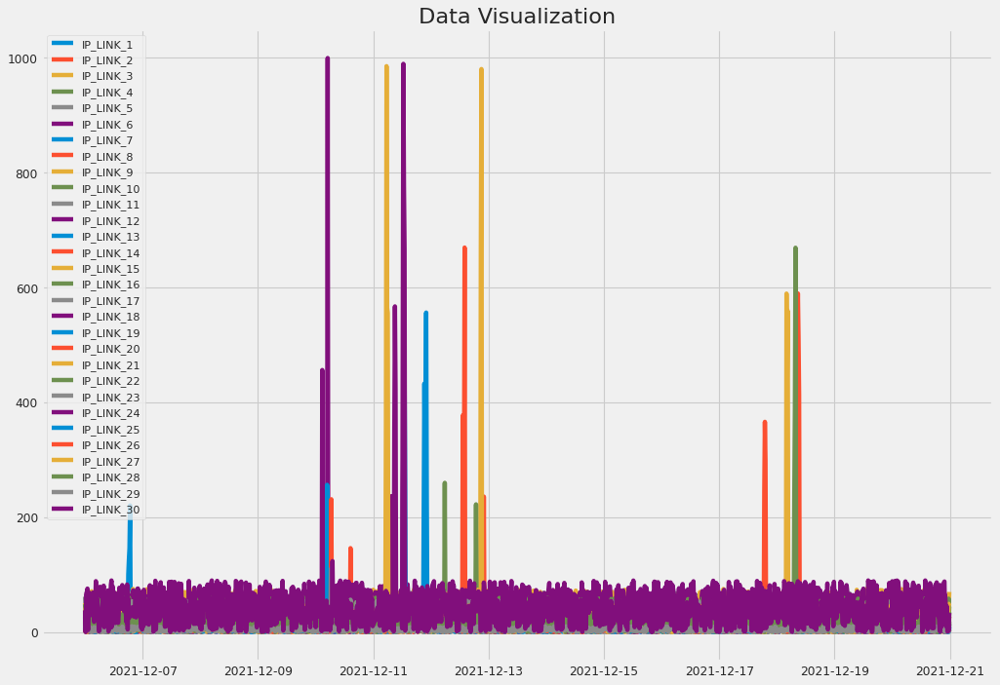

In [49]:
from matplotlib.pyplot import figure
figure(figsize=(14, 10), dpi=80)

params = {'legend.fontsize': 10,'legend.handlelength': 2}
plt.rcParams.update(params)
plt.plot(df_day[0], label="IP_LINK_1")
plt.plot(df_day[1], label="IP_LINK_2")
plt.plot(df_day[2], label="IP_LINK_3")
plt.plot(df_day[3], label="IP_LINK_4")
plt.plot(df_day[4], label="IP_LINK_5")
plt.plot(df_day[5], label="IP_LINK_6")
plt.plot(df_day[6], label="IP_LINK_7")
plt.plot(df_day[7], label="IP_LINK_8")
plt.plot(df_day[8], label="IP_LINK_9")
plt.plot(df_day[9], label="IP_LINK_10")
plt.plot(df_day[10], label="IP_LINK_11")
plt.plot(df_day[11], label="IP_LINK_12")
plt.plot(df_day[12], label="IP_LINK_13")
plt.plot(df_day[13], label="IP_LINK_14")
plt.plot(df_day[14], label="IP_LINK_15")
plt.plot(df_day[15], label="IP_LINK_16")
plt.plot(df_day[16], label="IP_LINK_17")
plt.plot(df_day[17], label="IP_LINK_18")
plt.plot(df_day[18], label="IP_LINK_19")
plt.plot(df_day[19], label="IP_LINK_20")
plt.plot(df_day[20], label="IP_LINK_21")
plt.plot(df_day[21], label="IP_LINK_22")
plt.plot(df_day[22], label="IP_LINK_23")
plt.plot(df_day[23], label="IP_LINK_24")
plt.plot(df_day[24], label="IP_LINK_25")
plt.plot(df_day[25], label="IP_LINK_26")
plt.plot(df_day[26], label="IP_LINK_27")
plt.plot(df_day[27], label="IP_LINK_28")
plt.plot(df_day[28], label="IP_LINK_29")
plt.plot(df_day[29], label="IP_LINK_30")

plt.title("Data Visualization")
plt.legend(loc="upper left")
plt.show()

In [50]:
print(df_day[0])

2021-12-06 00:00:00    4.78
2021-12-06 00:15:00    0.83
2021-12-06 00:30:00    3.37
2021-12-06 00:45:00    9.78
2021-12-06 01:00:00    1.27
                       ... 
2021-12-20 22:45:00    8.63
2021-12-20 23:00:00    9.62
2021-12-20 23:15:00    1.78
2021-12-20 23:30:00    0.51
2021-12-20 23:45:00    8.91
Freq: 15T, Name: 0, Length: 1440, dtype: float64


## Step 4.1: Visualize all Instances with plotly

In [51]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=df_day.index, y=df_day[i], name = "IP_Link_" + str(i+1)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with plotly")
fig.show()

## Step 4.2: Visualize all Instances with boxplot

In [52]:
import plotly.graph_objects as px
import numpy as np
 
plot = px.Figure()

for i in range(len(df_day.columns)):
    plot.add_trace(px.Box(y=df_day[i], name = "IP_Link_" + str(i+1)))

plot.update_layout(height=5000)
plot.show()

# Step 5: Outlier Detection

## Step 5.1: Isolation Forest Outlier Detection

In [53]:
import plotly.express as px

In [54]:
X = df_day.T

In [55]:
# Import Libraries
from sklearn.ensemble import IsolationForest

# Identify outliers in the training dataset
Isolation_Forest = IsolationForest()

outlier1 = pd.DataFrame()
list_1 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = Isolation_Forest.fit_predict(a)
    c = pd.DataFrame(b)
    print("\n\nOutliers Detected in IP_Link_"+str(i+1)+":", c[c == -1].count().sum())
    print("====================================\n")
    outlier1 = outlier1.append(c.T)
    list_1.append(c[c == -1].count().sum())

print("\nTotal Outliers Detected: ", outlier1[outlier1 == -1].count().sum())
print("=================================\n")

x = ["IP_Link_1",
    "IP_Link_2",
    "IP_Link_3",
    "IP_Link_4",
    "IP_Link_5",
    "IP_Link_6",
    "IP_Link_7",
    "IP_Link_8",
    "IP_Link_9",
    "IP_Link_10",
    "IP_Link_11",
    "IP_Link_12",
    "IP_Link_13",
    "IP_Link_14",
    "IP_Link_15",
    "IP_Link_16",
    "IP_Link_17",
    "IP_Link_18",
    "IP_Link_19",
    "IP_Link_20",
    "IP_Link_21",
    "IP_Link_22",
    "IP_Link_23",
    "IP_Link_24",
    "IP_Link_25",
    "IP_Link_26",
    "IP_Link_27",
    "IP_Link_28",
    "IP_Link_29",
    "IP_Link_30",
]
y = list_1

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by Isolation Forest:")
print("======================================\n")
outlier1 = outlier1.reset_index(drop=True)
outlier1

  0%|          | 0/30 [00:00<?, ?it/s]



Outliers Detected in IP_Link_1: 428



Outliers Detected in IP_Link_2: 302



Outliers Detected in IP_Link_3: 600



Outliers Detected in IP_Link_4: 359



Outliers Detected in IP_Link_5: 862



Outliers Detected in IP_Link_6: 704



Outliers Detected in IP_Link_7: 375



Outliers Detected in IP_Link_8: 189



Outliers Detected in IP_Link_9: 603



Outliers Detected in IP_Link_10: 469



Outliers Detected in IP_Link_11: 867



Outliers Detected in IP_Link_12: 1151



Outliers Detected in IP_Link_13: 824



Outliers Detected in IP_Link_14: 1116



Outliers Detected in IP_Link_15: 846



Outliers Detected in IP_Link_16: 1039



Outliers Detected in IP_Link_17: 687



Outliers Detected in IP_Link_18: 823



Outliers Detected in IP_Link_19: 1122



Outliers Detected in IP_Link_20: 792



Outliers Detected in IP_Link_21: 733



Outliers Detected in IP_Link_22: 785



Outliers Detected in IP_Link_23: 901



Outliers Detected in IP_Link_24: 303



Outliers Detected in IP_Link_25: 262



Out



Outliers Detected by Isolation Forest:



,0,1,2,3,4,5,6,7,8,9,...,1430,1431,1432,1433,1434,1435,1436,1437,1438,1439
0,1,-1,1,-1,-1,1,1,-1,1,1,...,-1,1,1,1,1,-1,-1,1,-1,-1
1,1,-1,-1,1,1,1,-1,-1,1,1,...,1,1,-1,-1,-1,1,-1,1,1,1
2,1,1,-1,-1,-1,1,1,-1,1,1,...,-1,1,1,-1,-1,1,1,-1,1,-1
3,1,1,-1,1,1,-1,1,-1,1,1,...,1,1,1,1,1,1,1,1,-1,-1
4,-1,-1,-1,-1,-1,1,1,-1,1,-1,...,-1,-1,-1,1,-1,-1,-1,-1,-1,-1
5,-1,1,-1,-1,-1,1,-1,-1,1,1,...,1,-1,-1,-1,1,-1,-1,-1,1,1
6,1,1,1,1,-1,1,1,-1,1,1,...,1,1,-1,1,1,1,1,1,1,1
7,1,1,1,1,1,1,1,1,1,1,...,-1,1,1,1,1,1,1,1,1,1
8,-1,-1,1,1,1,1,-1,1,1,-1,...,1,1,1,1,-1,1,-1,1,-1,-1
9,-1,1,-1,1,-1,1,1,1,1,1,...,-1,1,1,1,-1,-1,1,-1,1,-1


In [56]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="IP_Link_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier1.loc[i][outlier1.loc[i]==-1].index].index, y=X.loc[i][outlier1.loc[i][outlier1.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

## Step 5.2: AutoEncoders Outlier Detection 

In [57]:
import tensorflow as tf
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import MinMaxScaler
from tensorflow.keras import Model, Sequential
from tensorflow.keras.layers import Dense, Dropout
from sklearn.model_selection import train_test_split
from tensorflow.keras.losses import MeanSquaredLogarithmicError

2022-01-10 09:42:16.457377: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcudart.so.11.0'; dlerror: libcudart.so.11.0: cannot open shared object file: No such file or directory
2022-01-10 09:42:16.458240: I tensorflow/stream_executor/cuda/cudart_stub.cc:29] Ignore above cudart dlerror if you do not have a GPU set up on your machine.


In [58]:
class AutoEncoder(Model):
  def __init__(self, output_units, code_size=8):
    super().__init__()
    self.encoder = Sequential([
      Dense(64, activation='relu'),
      Dropout(0.1),
      Dense(32, activation='relu'),
      Dropout(0.1),
      Dense(16, activation='relu'),
      Dropout(0.1),
      Dense(code_size, activation='relu')
    ])
    self.decoder = Sequential([
      Dense(16, activation='relu'),
      Dropout(0.1),
      Dense(32, activation='relu'),
      Dropout(0.1),
      Dense(64, activation='relu'),
      Dropout(0.1),
      Dense(output_units, activation='sigmoid')
    ])
  
  def call(self, inputs):
    encoded = self.encoder(inputs)
    decoded = self.decoder(encoded)
    return decoded
  
model = AutoEncoder(output_units = 1)

2022-01-10 09:42:26.595800: W tensorflow/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libcuda.so.1'; dlerror: libcuda.so.1: cannot open shared object file: No such file or directory
2022-01-10 09:42:26.595915: W tensorflow/stream_executor/cuda/cuda_driver.cc:269] failed call to cuInit: UNKNOWN ERROR (303)
2022-01-10 09:42:26.595965: I tensorflow/stream_executor/cuda/cuda_diagnostics.cc:156] kernel driver does not appear to be running on this host (Nashit-Mashkoor): /proc/driver/nvidia/version does not exist
2022-01-10 09:42:26.596540: I tensorflow/core/platform/cpu_feature_guard.cc:151] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.


In [59]:
def find_threshold(model, x_train_scaled):
    reconstructions = model.predict(x_train_scaled)
    reconstruction_errors = tf.keras.losses.msle(reconstructions, x_train_scaled)
    threshold = np.mean(reconstruction_errors.numpy()) + np.std(reconstruction_errors.numpy())
    return threshold

In [60]:
def get_predictions(model, x_test_scaled, threshold):
    predictions = model.predict(x_test_scaled)
    errors = tf.keras.losses.msle(predictions, x_test_scaled)
    anomaly_mask = pd.Series(errors) > threshold
    preds = anomaly_mask.map(lambda x: 0.0 if x == True else 1.0)
    return preds

In [61]:
outlier2 = pd.DataFrame()
list_2 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    threshold = find_threshold(model, a)
    predictions = get_predictions(model, a, threshold)
    c = pd.DataFrame(predictions)
    c = c.replace({0: -1}).astype("int")
    print("\n\nOutliers Detected in IP_Link_"+str(i+1)+":", c[c == -1].count().sum())
    print("====================================\n")
    outlier2 = outlier2.append(c.T)
    list_2.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier2[outlier2 == -1].count().sum())
print("=================================\n")

x = ["IP_Link_1",
    "IP_Link_2",
    "IP_Link_3",
    "IP_Link_4",
    "IP_Link_5",
    "IP_Link_6",
    "IP_Link_7",
    "IP_Link_8",
    "IP_Link_9",
    "IP_Link_10",
    "IP_Link_11",
    "IP_Link_12",
    "IP_Link_13",
    "IP_Link_14",
    "IP_Link_15",
    "IP_Link_16",
    "IP_Link_17",
    "IP_Link_18",
    "IP_Link_19",
    "IP_Link_20",
    "IP_Link_21",
    "IP_Link_22",
    "IP_Link_23",
    "IP_Link_24",
    "IP_Link_25",
    "IP_Link_26",
    "IP_Link_27",
    "IP_Link_28",
    "IP_Link_29",
    "IP_Link_30",
]
y = list_2

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by Isolation Forest:")
print("======================================\n")
outlier2 = outlier2.reset_index(drop=True)
outlier2

  0%|          | 0/30 [00:00<?, ?it/s]



Outliers Detected in IP_Link_1: 139



Outliers Detected in IP_Link_2: 7



Outliers Detected in IP_Link_3: 3



Outliers Detected in IP_Link_4: 132



Outliers Detected in IP_Link_5: 321



Outliers Detected in IP_Link_6: 239



Outliers Detected in IP_Link_7: 209



Outliers Detected in IP_Link_8: 182



Outliers Detected in IP_Link_9: 20



Outliers Detected in IP_Link_10: 279



Outliers Detected in IP_Link_11: 278



Outliers Detected in IP_Link_12: 310



Outliers Detected in IP_Link_13: 294



Outliers Detected in IP_Link_14: 296



Outliers Detected in IP_Link_15: 265



Outliers Detected in IP_Link_16: 312



Outliers Detected in IP_Link_17: 298



Outliers Detected in IP_Link_18: 272



Outliers Detected in IP_Link_19: 299



Outliers Detected in IP_Link_20: 283



Outliers Detected in IP_Link_21: 265



Outliers Detected in IP_Link_22: 277



Outliers Detected in IP_Link_23: 289



Outliers Detected in IP_Link_24: 144



Outliers Detected in IP_Link_25: 9



Outliers Detec



Outliers Detected by Isolation Forest:



,0,1,2,3,4,5,6,7,8,9,...,1430,1431,1432,1433,1434,1435,1436,1437,1438,1439
0,1,1,1,-1,1,1,1,-1,1,1,...,-1,1,1,1,1,1,-1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,-1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,-1,1
4,1,1,1,1,1,1,1,1,1,1,...,1,-1,-1,1,1,-1,1,1,1,1
5,-1,1,1,1,1,1,-1,-1,1,1,...,1,1,1,-1,1,1,1,1,1,1
6,1,1,1,1,-1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,1,1,1,1,1,1,...,-1,1,1,-1,1,1,1,1,1,1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,-1,1,1,1,1,1,1,1,...,-1,1,1,1,-1,1,1,-1,1,-1


In [62]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="IP_Link_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier2.loc[i][outlier2.loc[i]==-1].index].index, y=X.loc[i][outlier2.loc[i][outlier2.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

## Step 5.3: Local Outlier Factor Outlier Detection 

In [63]:
# Import Libraries
from sklearn.neighbors import LocalOutlierFactor

# Identify outliers in the training dataset
Local_Outlier_Factor = LocalOutlierFactor()

outlier3 = pd.DataFrame()
list_3 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = Local_Outlier_Factor.fit_predict(a)
    c = pd.DataFrame(b)
    print("\n\nOutliers Detected in IP_Link_"+str(i+1)+":", c[c == -1].count().sum())
    print("====================================\n")
    outlier3 = outlier3.append(c.T)
    list_3.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier3[outlier3 == -1].count().sum())
print("=================================\n")

x = ["IP_Link_1",
    "IP_Link_2",
    "IP_Link_3",
    "IP_Link_4",
    "IP_Link_5",
    "IP_Link_6",
    "IP_Link_7",
    "IP_Link_8",
    "IP_Link_9",
    "IP_Link_10",
    "IP_Link_11",
    "IP_Link_12",
    "IP_Link_13",
    "IP_Link_14",
    "IP_Link_15",
    "IP_Link_16",
    "IP_Link_17",
    "IP_Link_18",
    "IP_Link_19",
    "IP_Link_20",
    "IP_Link_21",
    "IP_Link_22",
    "IP_Link_23",
    "IP_Link_24",
    "IP_Link_25",
    "IP_Link_26",
    "IP_Link_27",
    "IP_Link_28",
    "IP_Link_29",
    "IP_Link_30",
]
y = list_3

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by LocalOutlierFactor:")
print("========================================\n")
outlier3 = outlier3.reset_index(drop=True)
outlier3

  0%|          | 0/30 [00:00<?, ?it/s]



Outliers Detected in IP_Link_1: 5



Outliers Detected in IP_Link_2: 7



Outliers Detected in IP_Link_3: 5



Outliers Detected in IP_Link_4: 4



Outliers Detected in IP_Link_5: 0



Outliers Detected in IP_Link_6: 2



Outliers Detected in IP_Link_7: 6



Outliers Detected in IP_Link_8: 6



Outliers Detected in IP_Link_9: 2



Outliers Detected in IP_Link_10: 2



Outliers Detected in IP_Link_11: 0



Outliers Detected in IP_Link_12: 8



Outliers Detected in IP_Link_13: 0



Outliers Detected in IP_Link_14: 0



Outliers Detected in IP_Link_15: 0



Outliers Detected in IP_Link_16: 4



Outliers Detected in IP_Link_17: 0



Outliers Detected in IP_Link_18: 0



Outliers Detected in IP_Link_19: 0



Outliers Detected in IP_Link_20: 0



Outliers Detected in IP_Link_21: 2



Outliers Detected in IP_Link_22: 0



Outliers Detected in IP_Link_23: 1



Outliers Detected in IP_Link_24: 7



Outliers Detected in IP_Link_25: 4



Outliers Detected in IP_Link_26: 4



Outliers Detected i



Outliers Detected by LocalOutlierFactor:



,0,1,2,3,4,5,6,7,8,9,...,1430,1431,1432,1433,1434,1435,1436,1437,1438,1439
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
5,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
6,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [64]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="IP_Link_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier3.loc[i][outlier3.loc[i]==-1].index].index, y=X.loc[i][outlier3.loc[i][outlier3.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

## Step 5.4:  One Class SVM Outlier Detection

In [65]:
# Import Libraries
from sklearn.svm import OneClassSVM

# Identify outliers in the training dataset
One_Class_SVM = OneClassSVM()

outlier4 = pd.DataFrame()
list_4 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = One_Class_SVM.fit_predict(a)
    c = pd.DataFrame(b)
    print("\n\nOutliers Detected in IP_Link_"+str(i+1)+":", c[c == -1].count().sum())
    print("====================================\n")
    outlier4 = outlier4.append(c.T)
    list_4.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier4[outlier4 == -1].count().sum())
print("=================================\n")

x = ["IP_Link_1",
    "IP_Link_2",
    "IP_Link_3",
    "IP_Link_4",
    "IP_Link_5",
    "IP_Link_6",
    "IP_Link_7",
    "IP_Link_8",
    "IP_Link_9",
    "IP_Link_10",
    "IP_Link_11",
    "IP_Link_12",
    "IP_Link_13",
    "IP_Link_14",
    "IP_Link_15",
    "IP_Link_16",
    "IP_Link_17",
    "IP_Link_18",
    "IP_Link_19",
    "IP_Link_20",
    "IP_Link_21",
    "IP_Link_22",
    "IP_Link_23",
    "IP_Link_24",
    "IP_Link_25",
    "IP_Link_26",
    "IP_Link_27",
    "IP_Link_28",
    "IP_Link_29",
    "IP_Link_30",
]
y = list_4

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by OneClassSVM:")
print("=================================\n")
outlier4 = outlier4.reset_index(drop=True)
outlier4

  0%|          | 0/30 [00:00<?, ?it/s]



Outliers Detected in IP_Link_1: 721



Outliers Detected in IP_Link_2: 719



Outliers Detected in IP_Link_3: 718



Outliers Detected in IP_Link_4: 720



Outliers Detected in IP_Link_5: 718



Outliers Detected in IP_Link_6: 718



Outliers Detected in IP_Link_7: 721



Outliers Detected in IP_Link_8: 719



Outliers Detected in IP_Link_9: 722



Outliers Detected in IP_Link_10: 718



Outliers Detected in IP_Link_11: 719



Outliers Detected in IP_Link_12: 722



Outliers Detected in IP_Link_13: 720



Outliers Detected in IP_Link_14: 719



Outliers Detected in IP_Link_15: 720



Outliers Detected in IP_Link_16: 721



Outliers Detected in IP_Link_17: 720



Outliers Detected in IP_Link_18: 720



Outliers Detected in IP_Link_19: 719



Outliers Detected in IP_Link_20: 717



Outliers Detected in IP_Link_21: 722



Outliers Detected in IP_Link_22: 719



Outliers Detected in IP_Link_23: 719



Outliers Detected in IP_Link_24: 720



Outliers Detected in IP_Link_25: 722



Outlier



Outliers Detected by OneClassSVM:



,0,1,2,3,4,5,6,7,8,9,...,1430,1431,1432,1433,1434,1435,1436,1437,1438,1439
0,1,-1,1,-1,-1,1,1,-1,1,-1,...,-1,1,-1,1,1,-1,-1,-1,-1,-1
1,1,-1,-1,1,1,1,-1,-1,1,1,...,-1,1,-1,-1,-1,-1,-1,1,1,-1
2,1,1,-1,-1,-1,1,1,-1,1,1,...,-1,-1,-1,-1,-1,1,1,-1,-1,-1
3,1,-1,-1,1,-1,-1,1,-1,-1,1,...,-1,-1,1,1,1,1,-1,1,-1,-1
4,-1,-1,1,1,1,1,-1,-1,1,1,...,-1,-1,-1,1,1,-1,-1,-1,-1,1
5,-1,-1,-1,-1,-1,1,-1,-1,1,1,...,1,1,-1,-1,1,-1,-1,-1,1,1
6,1,-1,1,1,-1,-1,-1,-1,1,1,...,1,1,-1,-1,-1,1,1,1,1,1
7,1,-1,1,1,1,-1,-1,-1,1,-1,...,-1,1,1,-1,1,-1,1,-1,1,1
8,-1,-1,1,1,1,1,-1,-1,1,-1,...,-1,1,1,1,-1,1,-1,1,-1,-1
9,-1,1,-1,1,-1,-1,-1,-1,1,1,...,-1,1,1,1,-1,-1,1,1,1,-1


In [66]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="IP_Link_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier4.loc[i][outlier4.loc[i]==-1].index].index, y=X.loc[i][outlier4.loc[i][outlier4.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

# Step 5.5: DBSCAN Outlier Detection 

In [67]:
# Import Libraries
from sklearn.cluster import DBSCAN

# Identify outliers in the training dataset
outlier_detection = DBSCAN()

outlier5 = pd.DataFrame()
list_5 = []
for i in notebook.tqdm(range(len(X))):
    a = X.loc[i].to_numpy().reshape((len(X.loc[i]), 1))
    b = outlier_detection.fit_predict(a)
    c = pd.DataFrame(b)
    c = c.replace({0: 1}).astype("int")
    print("\n\nOutliers Detected in IP_Link_"+str(i+1)+":", c[c == -1].count().sum())
    print("====================================\n")
    outlier5 = outlier5.append(c.T)
    list_5.append(c[c == -1].count().sum())

print("\n\nNumber Outliers Detected: ", outlier5[outlier5 == -1].count().sum())
print("=================================\n")

x = ["IP_Link_1",
    "IP_Link_2",
    "IP_Link_3",
    "IP_Link_4",
    "IP_Link_5",
    "IP_Link_6",
    "IP_Link_7",
    "IP_Link_8",
    "IP_Link_9",
    "IP_Link_10",
    "IP_Link_11",
    "IP_Link_12",
    "IP_Link_13",
    "IP_Link_14",
    "IP_Link_15",
    "IP_Link_16",
    "IP_Link_17",
    "IP_Link_18",
    "IP_Link_19",
    "IP_Link_20",
    "IP_Link_21",
    "IP_Link_22",
    "IP_Link_23",
    "IP_Link_24",
    "IP_Link_25",
    "IP_Link_26",
    "IP_Link_27",
    "IP_Link_28",
    "IP_Link_29",
    "IP_Link_30",
]
y = list_5

fig = px.bar(x=x, y=y)
fig.show()

print("\n\nOutliers Detected by DBSCAN:")
print("============================\n")
outlier5 = outlier5.reset_index(drop=True)
for i in range(len(X)):
    outlier5.loc[i] = np.where(outlier5.loc[i] != -1, 1, outlier5.loc[i])
outlier5

  0%|          | 0/30 [00:00<?, ?it/s]



Outliers Detected in IP_Link_1: 4



Outliers Detected in IP_Link_2: 7



Outliers Detected in IP_Link_3: 3



Outliers Detected in IP_Link_4: 4



Outliers Detected in IP_Link_5: 0



Outliers Detected in IP_Link_6: 2



Outliers Detected in IP_Link_7: 6



Outliers Detected in IP_Link_8: 6



Outliers Detected in IP_Link_9: 2



Outliers Detected in IP_Link_10: 2



Outliers Detected in IP_Link_11: 0



Outliers Detected in IP_Link_12: 0



Outliers Detected in IP_Link_13: 0



Outliers Detected in IP_Link_14: 0



Outliers Detected in IP_Link_15: 0



Outliers Detected in IP_Link_16: 0



Outliers Detected in IP_Link_17: 0



Outliers Detected in IP_Link_18: 0



Outliers Detected in IP_Link_19: 0



Outliers Detected in IP_Link_20: 0



Outliers Detected in IP_Link_21: 0



Outliers Detected in IP_Link_22: 0



Outliers Detected in IP_Link_23: 1



Outliers Detected in IP_Link_24: 5



Outliers Detected in IP_Link_25: 4



Outliers Detected in IP_Link_26: 1



Outliers Detected i



Outliers Detected by DBSCAN:



,0,1,2,3,4,5,6,7,8,9,...,1430,1431,1432,1433,1434,1435,1436,1437,1438,1439
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
5,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
6,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


In [68]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

fig = make_subplots(rows=len(df_day.columns), cols=1)

for i in range(len(df_day.columns)):
    fig.add_trace(go.Scatter(x=X.loc[i].index, y=X.loc[i], name="IP_Link_" + str(i+1)),row=i+1, col=1)
    fig.add_trace (go.Scatter (x=X.loc[i][outlier5.loc[i][outlier5.loc[i]==-1].index].index, y=X.loc[i][outlier5.loc[i][outlier5.loc[i]==-1].index], 
                               mode = 'markers', name = 'normal', marker=dict (color='red', size=5)),row=i+1, col=1)

fig.update_layout(height=10000, width=800, title_text="Visualize all Instances with Anomlies")
fig.show()

# Step 6: Evaluate the Performance

## Step 6.1: Prepare Testing Data

In [69]:
import statistics

X_test = X.copy()
for i in notebook.tqdm(range(len(X_test))):
    condition = np.average(X_test.loc[i]) + 3 * (statistics.stdev(X_test.loc[i]))
    X_test.loc[i] = np.where(X_test.loc[i] > condition, -1, X_test.loc[i])

for i in notebook.tqdm(range(len(X_test))):
    X_test.loc[i] = np.where(X_test.loc[i] != -1, 1, X_test.loc[i])
    
X_test = X_test.astype("int")
X_test

  0%|          | 0/30 [00:00<?, ?it/s]

  0%|          | 0/30 [00:00<?, ?it/s]

,2021-12-06 00:00:00,2021-12-06 00:15:00,2021-12-06 00:30:00,2021-12-06 00:45:00,2021-12-06 01:00:00,2021-12-06 01:15:00,2021-12-06 01:30:00,2021-12-06 01:45:00,2021-12-06 02:00:00,2021-12-06 02:15:00,...,2021-12-20 21:30:00,2021-12-20 21:45:00,2021-12-20 22:00:00,2021-12-20 22:15:00,2021-12-20 22:30:00,2021-12-20 22:45:00,2021-12-20 23:00:00,2021-12-20 23:15:00,2021-12-20 23:30:00,2021-12-20 23:45:00
0,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
1,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
2,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
3,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
4,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
5,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
6,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
7,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
8,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1
9,1,1,1,1,1,1,1,1,1,1,...,1,1,1,1,1,1,1,1,1,1


## Step 6.2: Isolation Forest Outlier Detection



========================= IP_LINK_1 ======================




Accuracy Score:


  Accuracy:  70.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         4
           1       1.00      0.70      0.83      1436

    accuracy                           0.70      1440
   macro avg       0.50      0.85      0.42      1440
weighted avg       1.00      0.70      0.82      1440



Confusion Matrix:


[[   4    0]
 [ 426 1010]]


Confusion Matrix with Heat MAP:




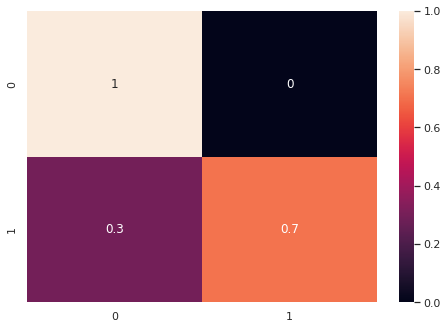



========================= IP_LINK_2 ======================




Accuracy Score:


  Accuracy:  83.47 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.06         7
           1       1.00      0.83      0.91      1433

    accuracy                           0.83      1440
   macro avg       0.51      0.92      0.48      1440
weighted avg       1.00      0.83      0.91      1440



Confusion Matrix:


[[   7    0]
 [ 238 1195]]


Confusion Matrix with Heat MAP:




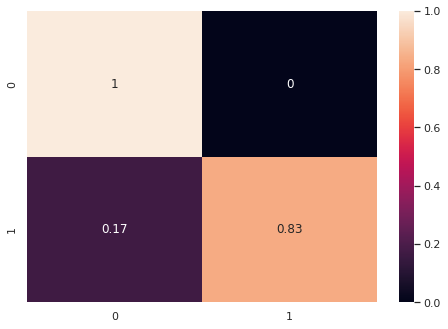



========================= IP_LINK_3 ======================




Accuracy Score:


  Accuracy:  63.12 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         3
           1       1.00      0.63      0.77      1437

    accuracy                           0.63      1440
   macro avg       0.50      0.82      0.39      1440
weighted avg       1.00      0.63      0.77      1440



Confusion Matrix:


[[  3   0]
 [531 906]]


Confusion Matrix with Heat MAP:




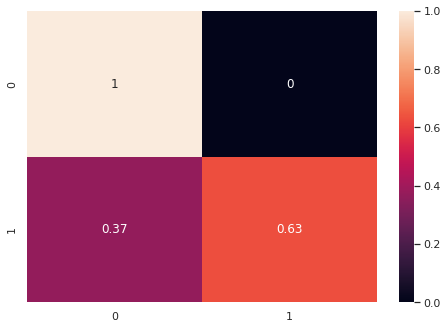



========================= IP_LINK_4 ======================




Accuracy Score:


  Accuracy:  73.47 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         4
           1       1.00      0.73      0.85      1436

    accuracy                           0.73      1440
   macro avg       0.51      0.87      0.43      1440
weighted avg       1.00      0.73      0.84      1440



Confusion Matrix:


[[   4    0]
 [ 382 1054]]


Confusion Matrix with Heat MAP:




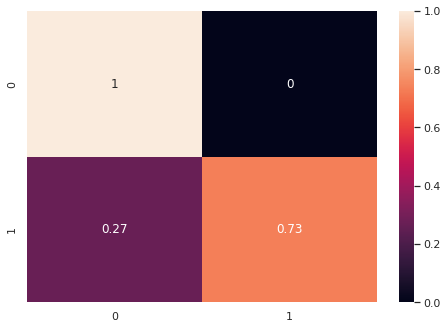



========================= IP_LINK_5 ======================




Accuracy Score:


  Accuracy:  53.89 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.54      0.70      1440

    accuracy                           0.54      1440
   macro avg       0.50      0.27      0.35      1440
weighted avg       1.00      0.54      0.70      1440



Confusion Matrix:


[[  0   0]
 [664 776]]


Confusion Matrix with Heat MAP:




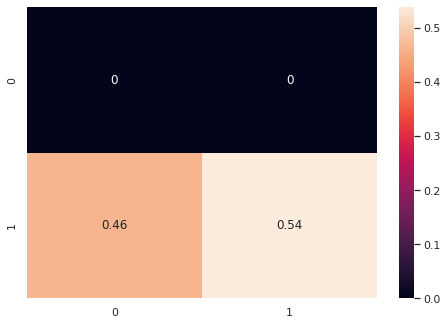



========================= IP_LINK_6 ======================




Accuracy Score:


  Accuracy:  67.5 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         2
           1       1.00      0.67      0.81      1438

    accuracy                           0.68      1440
   macro avg       0.50      0.84      0.41      1440
weighted avg       1.00      0.68      0.80      1440



Confusion Matrix:


[[  2   0]
 [468 970]]


Confusion Matrix with Heat MAP:




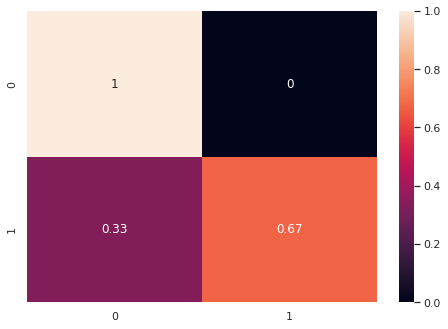



========================= IP_LINK_7 ======================




Accuracy Score:


  Accuracy:  78.68 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.04         6
           1       1.00      0.79      0.88      1434

    accuracy                           0.79      1440
   macro avg       0.51      0.89      0.46      1440
weighted avg       1.00      0.79      0.88      1440



Confusion Matrix:


[[   6    0]
 [ 307 1127]]


Confusion Matrix with Heat MAP:




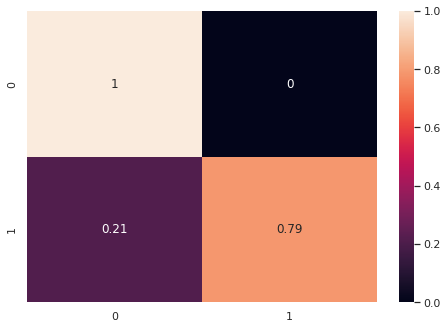



========================= IP_LINK_8 ======================




Accuracy Score:


  Accuracy:  79.1 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.04         6
           1       1.00      0.79      0.88      1434

    accuracy                           0.79      1440
   macro avg       0.51      0.90      0.46      1440
weighted avg       1.00      0.79      0.88      1440



Confusion Matrix:


[[   6    0]
 [ 301 1133]]


Confusion Matrix with Heat MAP:




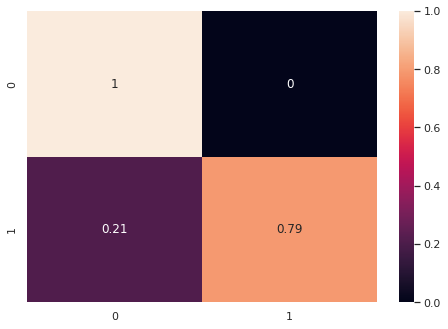



========================= IP_LINK_9 ======================




Accuracy Score:


  Accuracy:  55.21 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         2
           1       1.00      0.55      0.71      1438

    accuracy                           0.55      1440
   macro avg       0.50      0.78      0.36      1440
weighted avg       1.00      0.55      0.71      1440



Confusion Matrix:


[[  2   0]
 [645 793]]


Confusion Matrix with Heat MAP:




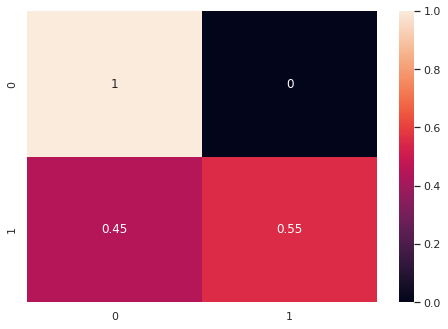



========================= IP_LINK_10 ======================




Accuracy Score:


  Accuracy:  51.94 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         2
           1       1.00      0.52      0.68      1438

    accuracy                           0.52      1440
   macro avg       0.50      0.76      0.34      1440
weighted avg       1.00      0.52      0.68      1440



Confusion Matrix:


[[  2   0]
 [692 746]]


Confusion Matrix with Heat MAP:




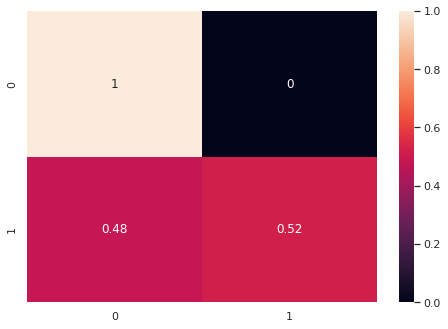



========================= IP_LINK_11 ======================




Accuracy Score:


  Accuracy:  41.39 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.41      0.59      1440

    accuracy                           0.41      1440
   macro avg       0.50      0.21      0.29      1440
weighted avg       1.00      0.41      0.59      1440



Confusion Matrix:


[[  0   0]
 [844 596]]


Confusion Matrix with Heat MAP:




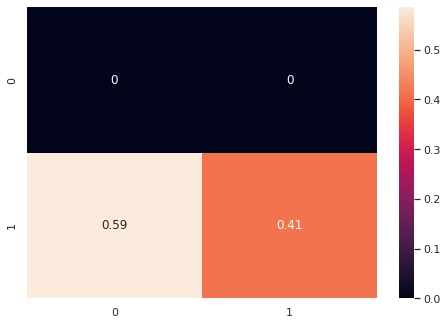



========================= IP_LINK_12 ======================




Accuracy Score:


  Accuracy:  41.04 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.41      0.58      1440

    accuracy                           0.41      1440
   macro avg       0.50      0.21      0.29      1440
weighted avg       1.00      0.41      0.58      1440



Confusion Matrix:


[[  0   0]
 [849 591]]


Confusion Matrix with Heat MAP:




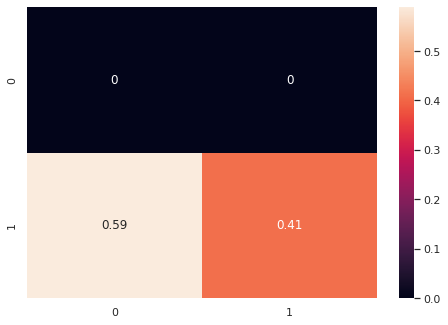



========================= IP_LINK_13 ======================




Accuracy Score:


  Accuracy:  48.82 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.49      0.66      1440

    accuracy                           0.49      1440
   macro avg       0.50      0.24      0.33      1440
weighted avg       1.00      0.49      0.66      1440



Confusion Matrix:


[[  0   0]
 [737 703]]


Confusion Matrix with Heat MAP:




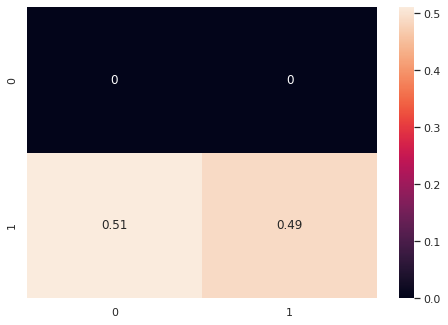



========================= IP_LINK_14 ======================




Accuracy Score:


  Accuracy:  38.4 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.38      0.55      1440

    accuracy                           0.38      1440
   macro avg       0.50      0.19      0.28      1440
weighted avg       1.00      0.38      0.55      1440



Confusion Matrix:


[[  0   0]
 [887 553]]


Confusion Matrix with Heat MAP:




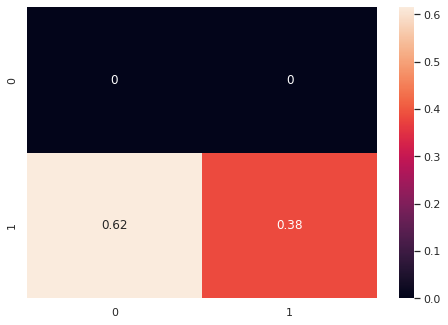



========================= IP_LINK_15 ======================




Accuracy Score:


  Accuracy:  54.31 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.54      0.70      1440

    accuracy                           0.54      1440
   macro avg       0.50      0.27      0.35      1440
weighted avg       1.00      0.54      0.70      1440



Confusion Matrix:


[[  0   0]
 [658 782]]


Confusion Matrix with Heat MAP:




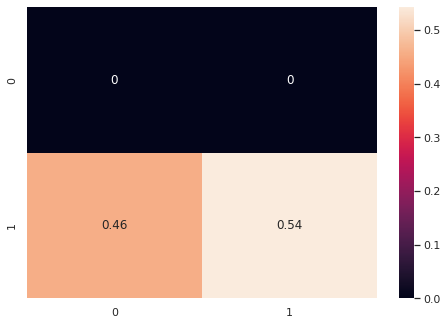



========================= IP_LINK_16 ======================




Accuracy Score:


  Accuracy:  38.33 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.38      0.55      1440

    accuracy                           0.38      1440
   macro avg       0.50      0.19      0.28      1440
weighted avg       1.00      0.38      0.55      1440



Confusion Matrix:


[[  0   0]
 [888 552]]


Confusion Matrix with Heat MAP:




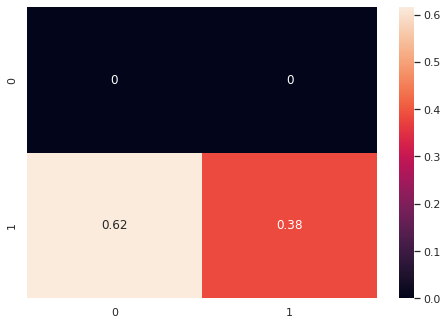



========================= IP_LINK_17 ======================




Accuracy Score:


  Accuracy:  34.17 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.34      0.51      1440

    accuracy                           0.34      1440
   macro avg       0.50      0.17      0.25      1440
weighted avg       1.00      0.34      0.51      1440



Confusion Matrix:


[[  0   0]
 [948 492]]


Confusion Matrix with Heat MAP:




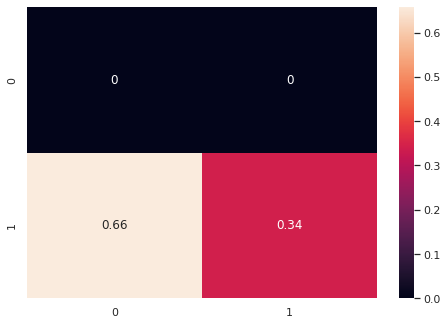



========================= IP_LINK_18 ======================




Accuracy Score:


  Accuracy:  42.64 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.43      0.60      1440

    accuracy                           0.43      1440
   macro avg       0.50      0.21      0.30      1440
weighted avg       1.00      0.43      0.60      1440



Confusion Matrix:


[[  0   0]
 [826 614]]


Confusion Matrix with Heat MAP:




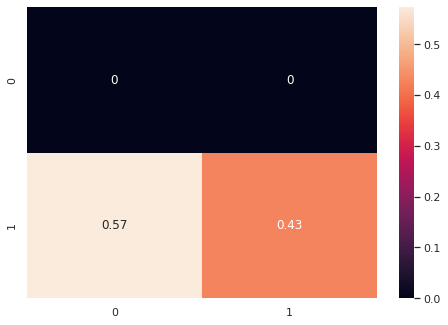



========================= IP_LINK_19 ======================




Accuracy Score:


  Accuracy:  47.29 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.47      0.64      1440

    accuracy                           0.47      1440
   macro avg       0.50      0.24      0.32      1440
weighted avg       1.00      0.47      0.64      1440



Confusion Matrix:


[[  0   0]
 [759 681]]


Confusion Matrix with Heat MAP:




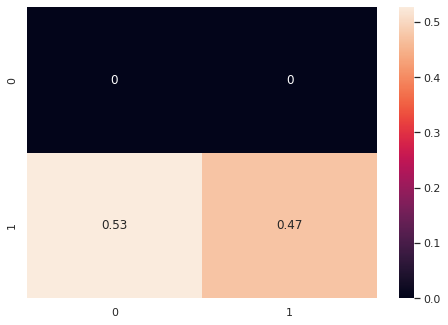



========================= IP_LINK_20 ======================




Accuracy Score:


  Accuracy:  45.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.45      0.62      1440

    accuracy                           0.45      1440
   macro avg       0.50      0.23      0.31      1440
weighted avg       1.00      0.45      0.62      1440



Confusion Matrix:


[[  0   0]
 [786 654]]


Confusion Matrix with Heat MAP:




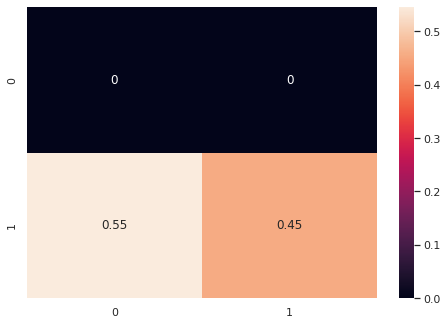



========================= IP_LINK_21 ======================




Accuracy Score:


  Accuracy:  44.1 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.44      0.61      1440

    accuracy                           0.44      1440
   macro avg       0.50      0.22      0.31      1440
weighted avg       1.00      0.44      0.61      1440



Confusion Matrix:


[[  0   0]
 [805 635]]


Confusion Matrix with Heat MAP:




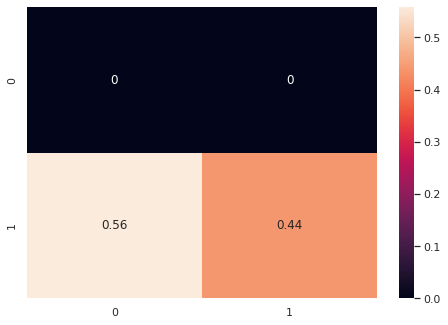



========================= IP_LINK_22 ======================




Accuracy Score:


  Accuracy:  45.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.45      0.62      1440

    accuracy                           0.45      1440
   macro avg       0.50      0.23      0.31      1440
weighted avg       1.00      0.45      0.62      1440



Confusion Matrix:


[[  0   0]
 [792 648]]


Confusion Matrix with Heat MAP:




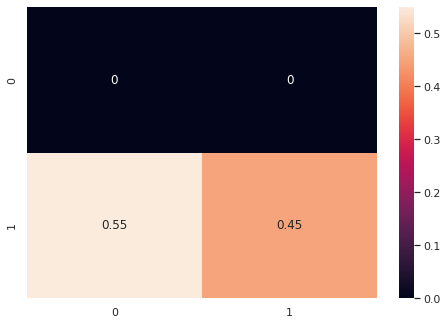



========================= IP_LINK_23 ======================




Accuracy Score:


  Accuracy:  42.15 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.42      0.59      1440

    accuracy                           0.42      1440
   macro avg       0.50      0.21      0.30      1440
weighted avg       1.00      0.42      0.59      1440



Confusion Matrix:


[[  0   0]
 [833 607]]


Confusion Matrix with Heat MAP:




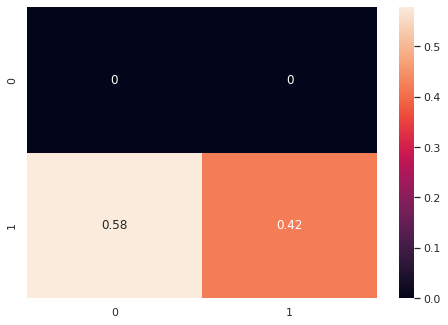



========================= IP_LINK_24 ======================




Accuracy Score:


  Accuracy:  79.51 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.03         5
           1       1.00      0.79      0.89      1435

    accuracy                           0.80      1440
   macro avg       0.51      0.90      0.46      1440
weighted avg       1.00      0.80      0.88      1440



Confusion Matrix:


[[   5    0]
 [ 295 1140]]


Confusion Matrix with Heat MAP:




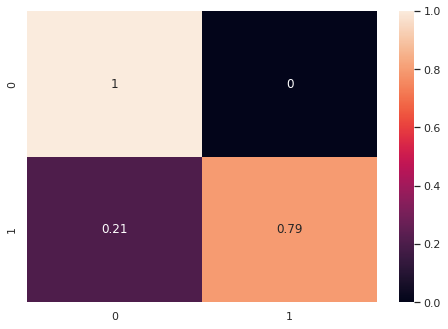



========================= IP_LINK_25 ======================




Accuracy Score:


  Accuracy:  80.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.03         4
           1       1.00      0.80      0.89      1436

    accuracy                           0.80      1440
   macro avg       0.51      0.90      0.46      1440
weighted avg       1.00      0.80      0.89      1440



Confusion Matrix:


[[   4    0]
 [ 287 1149]]


Confusion Matrix with Heat MAP:




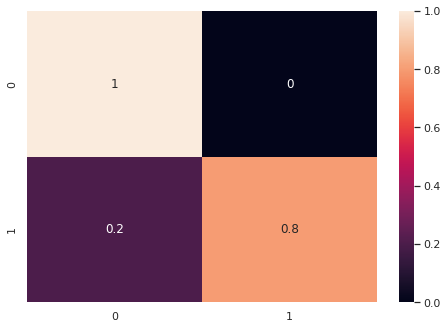



========================= IP_LINK_26 ======================




Accuracy Score:


  Accuracy:  57.43 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.00         1
           1       1.00      0.57      0.73      1439

    accuracy                           0.57      1440
   macro avg       0.50      0.79      0.37      1440
weighted avg       1.00      0.57      0.73      1440



Confusion Matrix:


[[  1   0]
 [613 826]]


Confusion Matrix with Heat MAP:




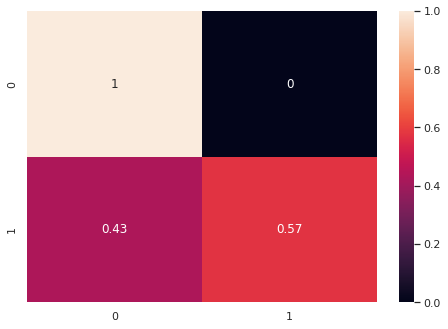



========================= IP_LINK_27 ======================




Accuracy Score:


  Accuracy:  75.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         4
           1       1.00      0.75      0.86      1436

    accuracy                           0.75      1440
   macro avg       0.51      0.88      0.44      1440
weighted avg       1.00      0.75      0.85      1440



Confusion Matrix:


[[   4    0]
 [ 359 1077]]


Confusion Matrix with Heat MAP:




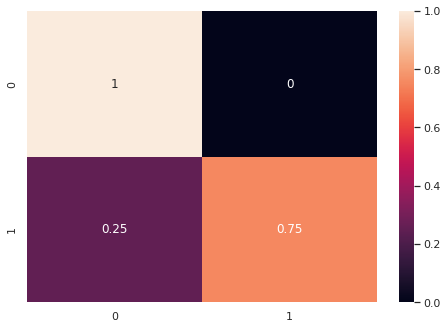



========================= IP_LINK_28 ======================




Accuracy Score:


  Accuracy:  35.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.35      0.52      1440

    accuracy                           0.35      1440
   macro avg       0.50      0.18      0.26      1440
weighted avg       1.00      0.35      0.52      1440



Confusion Matrix:


[[  0   0]
 [930 510]]


Confusion Matrix with Heat MAP:




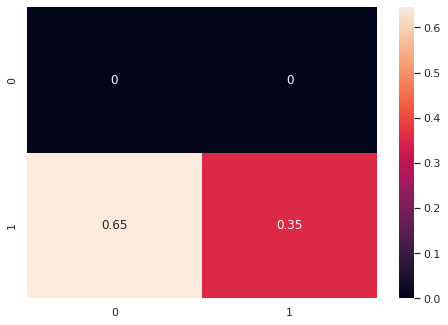



========================= IP_LINK_29 ======================




Accuracy Score:


  Accuracy:  52.57 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.00         1
           1       1.00      0.53      0.69      1439

    accuracy                           0.53      1440
   macro avg       0.50      0.76      0.35      1440
weighted avg       1.00      0.53      0.69      1440



Confusion Matrix:


[[  1   0]
 [683 756]]


Confusion Matrix with Heat MAP:




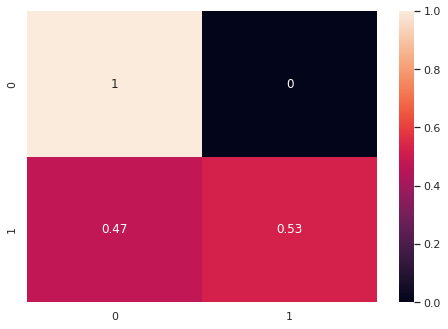



========================= IP_LINK_30 ======================




Accuracy Score:


  Accuracy:  81.46 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.04         5
           1       1.00      0.81      0.90      1435

    accuracy                           0.81      1440
   macro avg       0.51      0.91      0.47      1440
weighted avg       1.00      0.81      0.89      1440



Confusion Matrix:


[[   5    0]
 [ 267 1168]]


Confusion Matrix with Heat MAP:




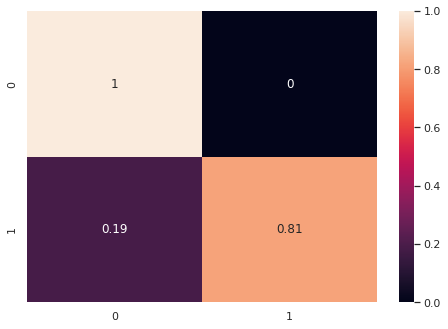

In [39]:
accuracy_1 = dict()
for i in range(30):
    
    print("\n\n ========================================================")
    print("========================= IP_LINK_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier1.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_1[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_1[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.3: Autoencoder Outlier Detection



========================= IP_LINK_1 ======================




Accuracy Score:


  Accuracy:  90.62 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.06         4
           1       1.00      0.91      0.95      1436

    accuracy                           0.91      1440
   macro avg       0.51      0.95      0.50      1440
weighted avg       1.00      0.91      0.95      1440



Confusion Matrix:


[[   4    0]
 [ 135 1301]]


Confusion Matrix with Heat MAP:




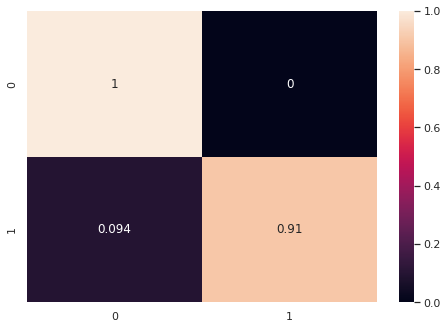



========================= IP_LINK_2 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         7
           1       1.00      1.00      1.00      1433

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   7    0]
 [   0 1433]]


Confusion Matrix with Heat MAP:




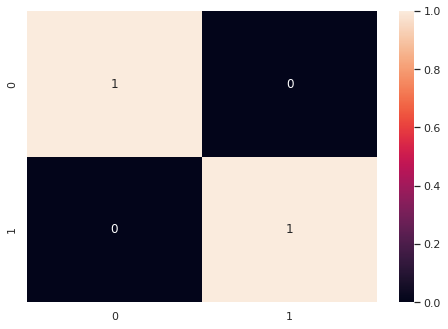



========================= IP_LINK_3 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         3
           1       1.00      1.00      1.00      1437

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   3    0]
 [   0 1437]]


Confusion Matrix with Heat MAP:




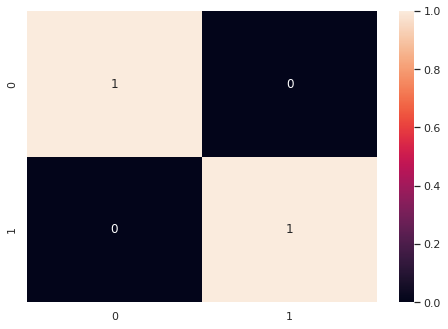



========================= IP_LINK_4 ======================




Accuracy Score:


  Accuracy:  91.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.06         4
           1       1.00      0.91      0.95      1436

    accuracy                           0.91      1440
   macro avg       0.52      0.96      0.51      1440
weighted avg       1.00      0.91      0.95      1440



Confusion Matrix:


[[   4    0]
 [ 128 1308]]


Confusion Matrix with Heat MAP:




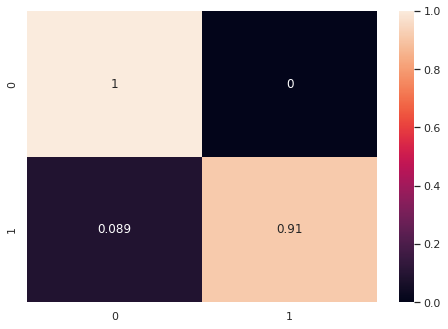



========================= IP_LINK_5 ======================




Accuracy Score:


  Accuracy:  77.71 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.78      0.87      1440

    accuracy                           0.78      1440
   macro avg       0.50      0.39      0.44      1440
weighted avg       1.00      0.78      0.87      1440



Confusion Matrix:


[[   0    0]
 [ 321 1119]]


Confusion Matrix with Heat MAP:




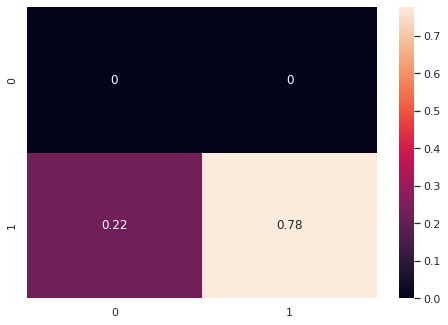



========================= IP_LINK_6 ======================




Accuracy Score:


  Accuracy:  83.54 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         2
           1       1.00      0.84      0.91      1438

    accuracy                           0.84      1440
   macro avg       0.50      0.92      0.46      1440
weighted avg       1.00      0.84      0.91      1440



Confusion Matrix:


[[   2    0]
 [ 237 1201]]


Confusion Matrix with Heat MAP:




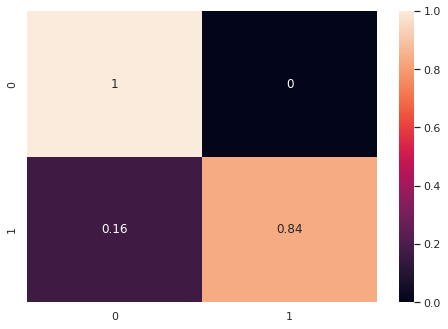



========================= IP_LINK_7 ======================




Accuracy Score:


  Accuracy:  85.9 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.06         6
           1       1.00      0.86      0.92      1434

    accuracy                           0.86      1440
   macro avg       0.51      0.93      0.49      1440
weighted avg       1.00      0.86      0.92      1440



Confusion Matrix:


[[   6    0]
 [ 203 1231]]


Confusion Matrix with Heat MAP:




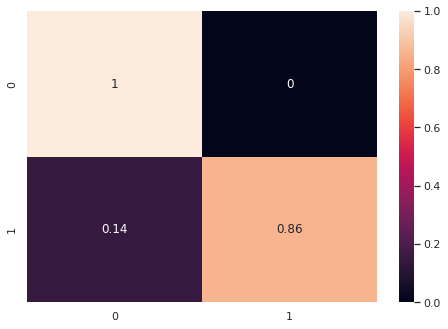



========================= IP_LINK_8 ======================




Accuracy Score:


  Accuracy:  87.78 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.06         6
           1       1.00      0.88      0.93      1434

    accuracy                           0.88      1440
   macro avg       0.52      0.94      0.50      1440
weighted avg       1.00      0.88      0.93      1440



Confusion Matrix:


[[   6    0]
 [ 176 1258]]


Confusion Matrix with Heat MAP:




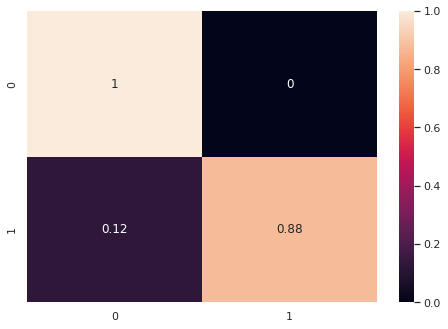



========================= IP_LINK_9 ======================




Accuracy Score:


  Accuracy:  98.75 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.10      1.00      0.18         2
           1       1.00      0.99      0.99      1438

    accuracy                           0.99      1440
   macro avg       0.55      0.99      0.59      1440
weighted avg       1.00      0.99      0.99      1440



Confusion Matrix:


[[   2    0]
 [  18 1420]]


Confusion Matrix with Heat MAP:




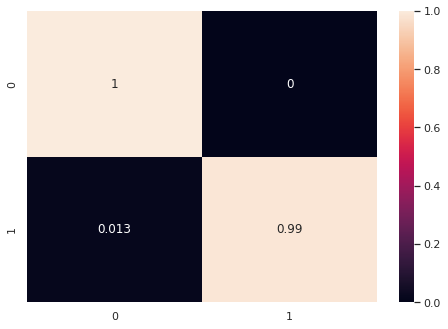



========================= IP_LINK_10 ======================




Accuracy Score:


  Accuracy:  80.76 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         2
           1       1.00      0.81      0.89      1438

    accuracy                           0.81      1440
   macro avg       0.50      0.90      0.45      1440
weighted avg       1.00      0.81      0.89      1440



Confusion Matrix:


[[   2    0]
 [ 277 1161]]


Confusion Matrix with Heat MAP:




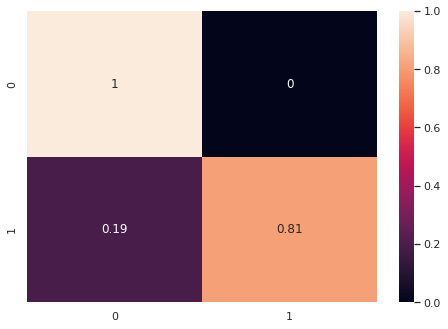



========================= IP_LINK_11 ======================




Accuracy Score:


  Accuracy:  80.69 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.81      0.89      1440

    accuracy                           0.81      1440
   macro avg       0.50      0.40      0.45      1440
weighted avg       1.00      0.81      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 278 1162]]


Confusion Matrix with Heat MAP:




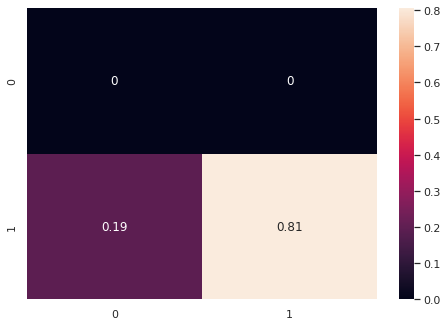



========================= IP_LINK_12 ======================




Accuracy Score:


  Accuracy:  78.47 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.78      0.88      1440

    accuracy                           0.78      1440
   macro avg       0.50      0.39      0.44      1440
weighted avg       1.00      0.78      0.88      1440



Confusion Matrix:


[[   0    0]
 [ 310 1130]]


Confusion Matrix with Heat MAP:




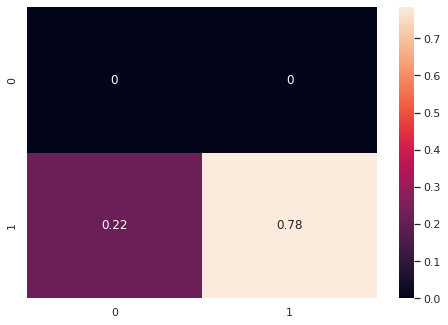



========================= IP_LINK_13 ======================




Accuracy Score:


  Accuracy:  79.58 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.80      0.89      1440

    accuracy                           0.80      1440
   macro avg       0.50      0.40      0.44      1440
weighted avg       1.00      0.80      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 294 1146]]


Confusion Matrix with Heat MAP:




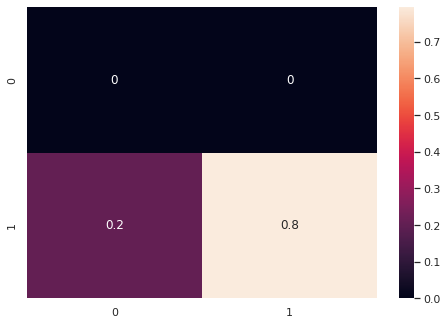



========================= IP_LINK_14 ======================




Accuracy Score:


  Accuracy:  79.44 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.79      0.89      1440

    accuracy                           0.79      1440
   macro avg       0.50      0.40      0.44      1440
weighted avg       1.00      0.79      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 296 1144]]


Confusion Matrix with Heat MAP:




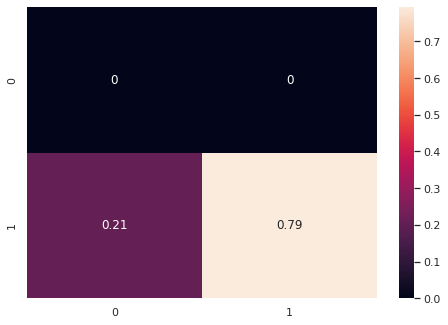



========================= IP_LINK_15 ======================




Accuracy Score:


  Accuracy:  81.6 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.82      0.90      1440

    accuracy                           0.82      1440
   macro avg       0.50      0.41      0.45      1440
weighted avg       1.00      0.82      0.90      1440



Confusion Matrix:


[[   0    0]
 [ 265 1175]]


Confusion Matrix with Heat MAP:




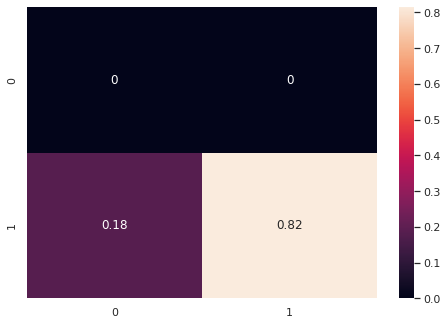



========================= IP_LINK_16 ======================




Accuracy Score:


  Accuracy:  78.33 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.78      0.88      1440

    accuracy                           0.78      1440
   macro avg       0.50      0.39      0.44      1440
weighted avg       1.00      0.78      0.88      1440



Confusion Matrix:


[[   0    0]
 [ 312 1128]]


Confusion Matrix with Heat MAP:




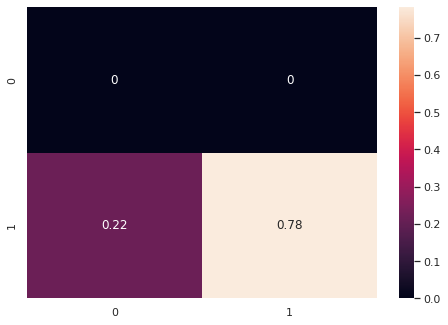



========================= IP_LINK_17 ======================




Accuracy Score:


  Accuracy:  79.31 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.79      0.88      1440

    accuracy                           0.79      1440
   macro avg       0.50      0.40      0.44      1440
weighted avg       1.00      0.79      0.88      1440



Confusion Matrix:


[[   0    0]
 [ 298 1142]]


Confusion Matrix with Heat MAP:




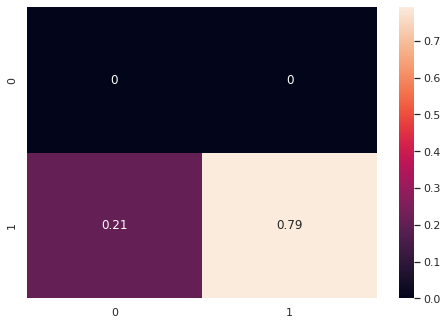



========================= IP_LINK_18 ======================




Accuracy Score:


  Accuracy:  81.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.81      0.90      1440

    accuracy                           0.81      1440
   macro avg       0.50      0.41      0.45      1440
weighted avg       1.00      0.81      0.90      1440



Confusion Matrix:


[[   0    0]
 [ 272 1168]]


Confusion Matrix with Heat MAP:




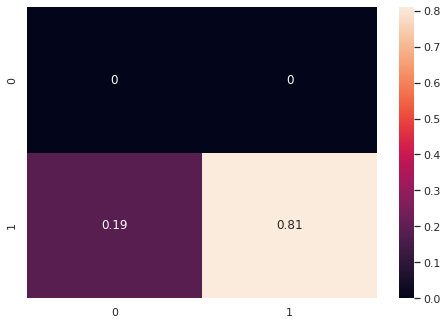



========================= IP_LINK_19 ======================




Accuracy Score:


  Accuracy:  79.24 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.79      0.88      1440

    accuracy                           0.79      1440
   macro avg       0.50      0.40      0.44      1440
weighted avg       1.00      0.79      0.88      1440



Confusion Matrix:


[[   0    0]
 [ 299 1141]]


Confusion Matrix with Heat MAP:




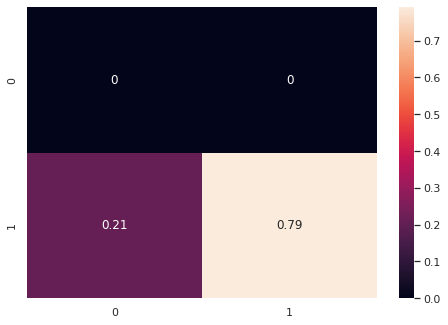



========================= IP_LINK_20 ======================




Accuracy Score:


  Accuracy:  80.35 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.80      0.89      1440

    accuracy                           0.80      1440
   macro avg       0.50      0.40      0.45      1440
weighted avg       1.00      0.80      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 283 1157]]


Confusion Matrix with Heat MAP:




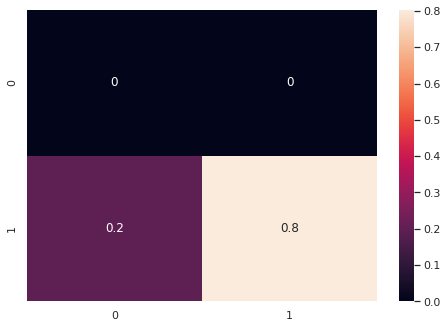



========================= IP_LINK_21 ======================




Accuracy Score:


  Accuracy:  81.6 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.82      0.90      1440

    accuracy                           0.82      1440
   macro avg       0.50      0.41      0.45      1440
weighted avg       1.00      0.82      0.90      1440



Confusion Matrix:


[[   0    0]
 [ 265 1175]]


Confusion Matrix with Heat MAP:




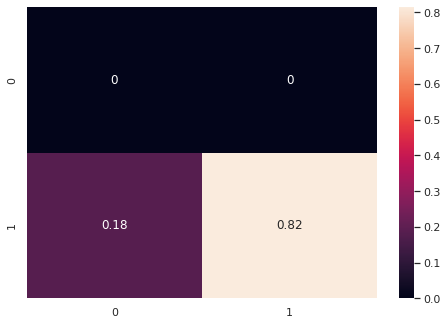



========================= IP_LINK_22 ======================




Accuracy Score:


  Accuracy:  80.76 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.81      0.89      1440

    accuracy                           0.81      1440
   macro avg       0.50      0.40      0.45      1440
weighted avg       1.00      0.81      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 277 1163]]


Confusion Matrix with Heat MAP:




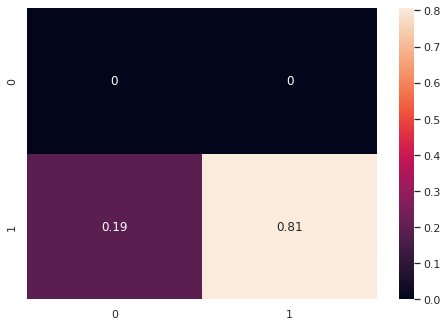



========================= IP_LINK_23 ======================




Accuracy Score:


  Accuracy:  79.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.80      0.89      1440

    accuracy                           0.80      1440
   macro avg       0.50      0.40      0.44      1440
weighted avg       1.00      0.80      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 289 1151]]


Confusion Matrix with Heat MAP:




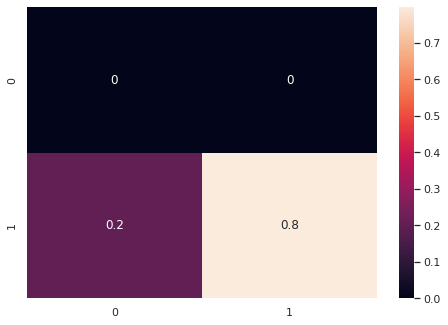



========================= IP_LINK_24 ======================




Accuracy Score:


  Accuracy:  90.35 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.03      1.00      0.07         5
           1       1.00      0.90      0.95      1435

    accuracy                           0.90      1440
   macro avg       0.52      0.95      0.51      1440
weighted avg       1.00      0.90      0.95      1440



Confusion Matrix:


[[   5    0]
 [ 139 1296]]


Confusion Matrix with Heat MAP:




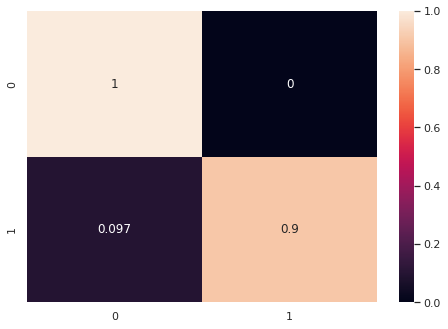



========================= IP_LINK_25 ======================




Accuracy Score:


  Accuracy:  99.65 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.44      1.00      0.62         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       0.72      1.00      0.81      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   5 1431]]


Confusion Matrix with Heat MAP:




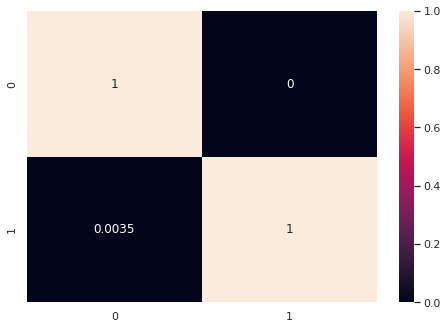



========================= IP_LINK_26 ======================




Accuracy Score:


  Accuracy:  80.69 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         1
           1       1.00      0.81      0.89      1439

    accuracy                           0.81      1440
   macro avg       0.50      0.90      0.45      1440
weighted avg       1.00      0.81      0.89      1440



Confusion Matrix:


[[   1    0]
 [ 278 1161]]


Confusion Matrix with Heat MAP:




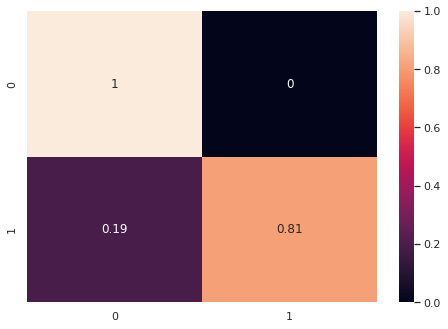



========================= IP_LINK_27 ======================




Accuracy Score:


  Accuracy:  85.49 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.04         4
           1       1.00      0.85      0.92      1436

    accuracy                           0.85      1440
   macro avg       0.51      0.93      0.48      1440
weighted avg       1.00      0.85      0.92      1440



Confusion Matrix:


[[   4    0]
 [ 209 1227]]


Confusion Matrix with Heat MAP:




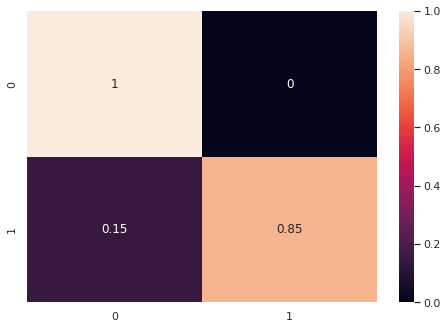



========================= IP_LINK_28 ======================




Accuracy Score:


  Accuracy:  79.44 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.79      0.89      1440

    accuracy                           0.79      1440
   macro avg       0.50      0.40      0.44      1440
weighted avg       1.00      0.79      0.89      1440



Confusion Matrix:


[[   0    0]
 [ 296 1144]]


Confusion Matrix with Heat MAP:




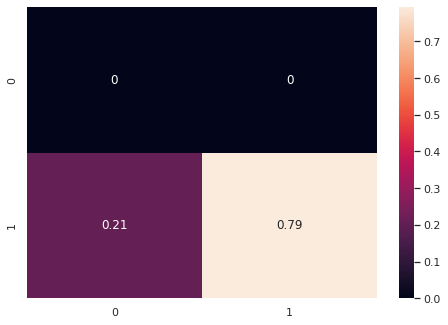



========================= IP_LINK_29 ======================




Accuracy Score:


  Accuracy:  80.83 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         1
           1       1.00      0.81      0.89      1439

    accuracy                           0.81      1440
   macro avg       0.50      0.90      0.45      1440
weighted avg       1.00      0.81      0.89      1440



Confusion Matrix:


[[   1    0]
 [ 276 1163]]


Confusion Matrix with Heat MAP:




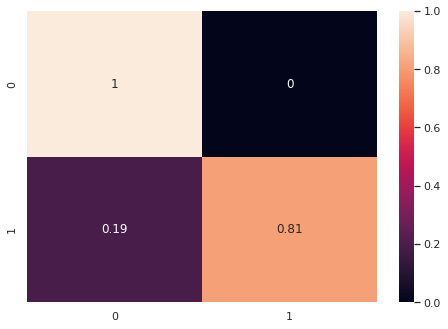



========================= IP_LINK_30 ======================




Accuracy Score:


  Accuracy:  86.11 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.02      1.00      0.05         5
           1       1.00      0.86      0.93      1435

    accuracy                           0.86      1440
   macro avg       0.51      0.93      0.49      1440
weighted avg       1.00      0.86      0.92      1440



Confusion Matrix:


[[   5    0]
 [ 200 1235]]


Confusion Matrix with Heat MAP:




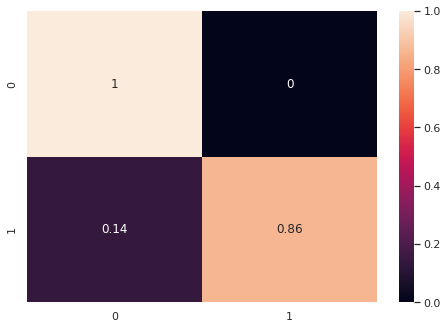

In [70]:
accuracy_2 = dict()
for i in range(30):
    
    print("\n\n ========================================================")
    print("========================= IP_LINK_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier2.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_2[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_2[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.4: Local Outlier Factor Outlier Detection



========================= IP_LINK_1 ======================




Accuracy Score:


  Accuracy:  99.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.80      1.00      0.89         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       0.90      1.00      0.94      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   1 1435]]


Confusion Matrix with Heat MAP:




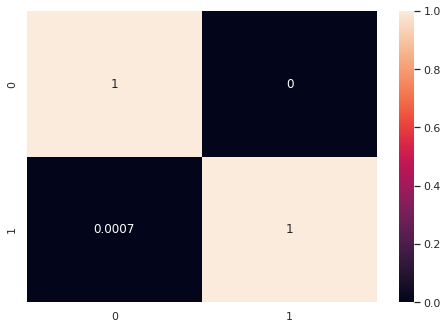



========================= IP_LINK_2 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         7
           1       1.00      1.00      1.00      1433

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   7    0]
 [   0 1433]]


Confusion Matrix with Heat MAP:




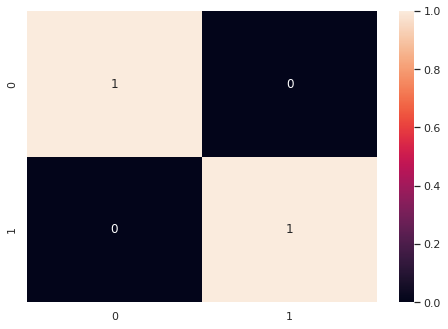



========================= IP_LINK_3 ======================




Accuracy Score:


  Accuracy:  99.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.60      1.00      0.75         3
           1       1.00      1.00      1.00      1437

    accuracy                           1.00      1440
   macro avg       0.80      1.00      0.87      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   3    0]
 [   2 1435]]


Confusion Matrix with Heat MAP:




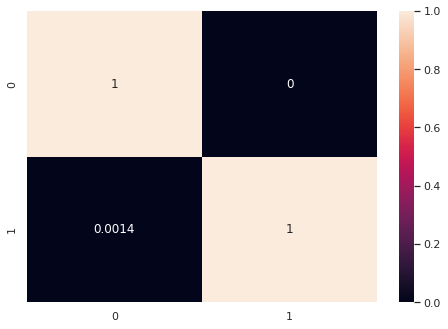



========================= IP_LINK_4 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




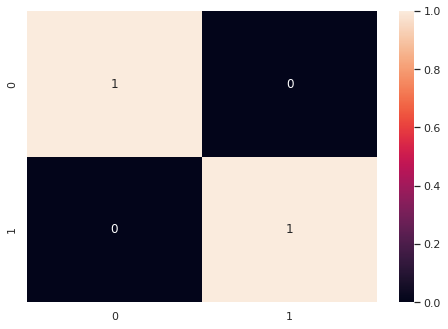



========================= IP_LINK_5 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




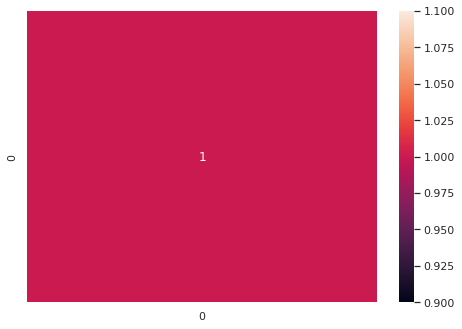



========================= IP_LINK_6 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         2
           1       1.00      1.00      1.00      1438

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   2    0]
 [   0 1438]]


Confusion Matrix with Heat MAP:




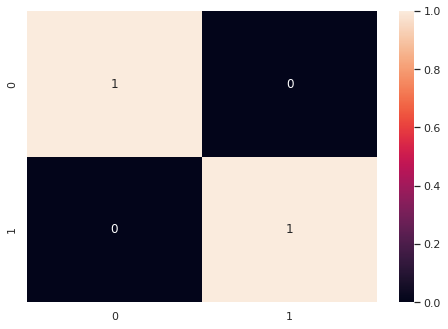



========================= IP_LINK_7 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         6
           1       1.00      1.00      1.00      1434

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   6    0]
 [   0 1434]]


Confusion Matrix with Heat MAP:




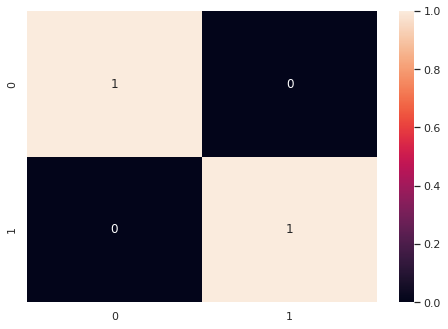



========================= IP_LINK_8 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         6
           1       1.00      1.00      1.00      1434

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   6    0]
 [   0 1434]]


Confusion Matrix with Heat MAP:




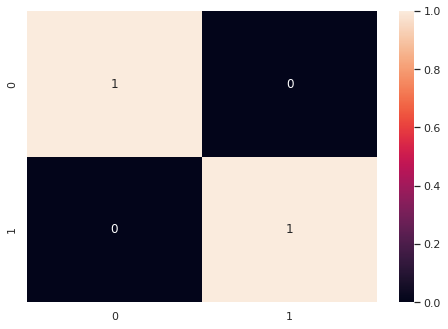



========================= IP_LINK_9 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         2
           1       1.00      1.00      1.00      1438

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   2    0]
 [   0 1438]]


Confusion Matrix with Heat MAP:




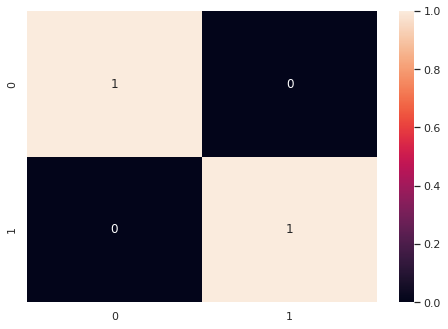



========================= IP_LINK_10 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         2
           1       1.00      1.00      1.00      1438

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   2    0]
 [   0 1438]]


Confusion Matrix with Heat MAP:




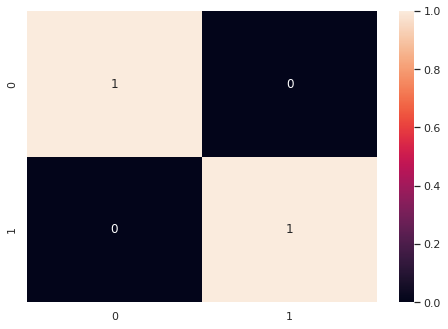



========================= IP_LINK_11 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




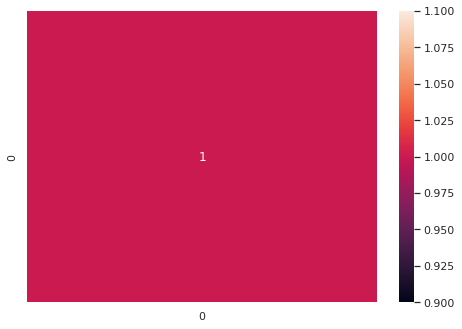



========================= IP_LINK_12 ======================




Accuracy Score:


  Accuracy:  99.44 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.99      1.00      1440

    accuracy                           0.99      1440
   macro avg       0.50      0.50      0.50      1440
weighted avg       1.00      0.99      1.00      1440



Confusion Matrix:


[[   0    0]
 [   8 1432]]


Confusion Matrix with Heat MAP:




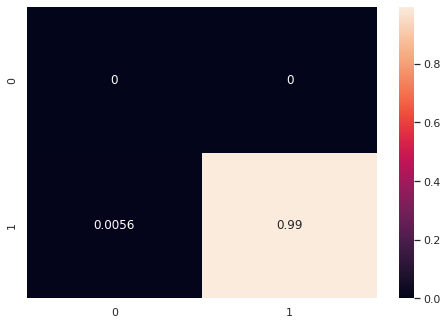



========================= IP_LINK_13 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




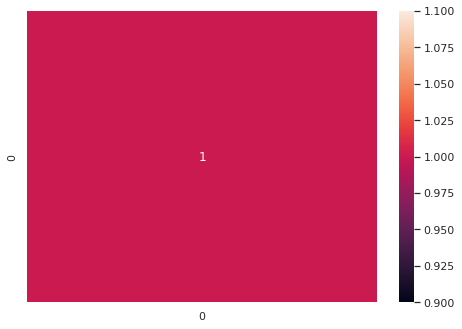



========================= IP_LINK_14 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




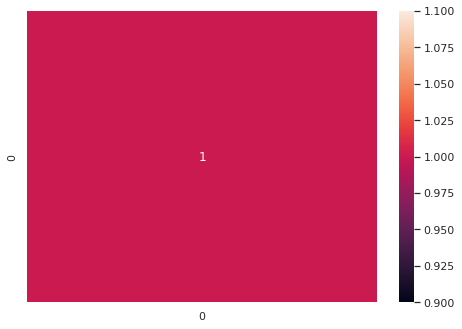



========================= IP_LINK_15 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




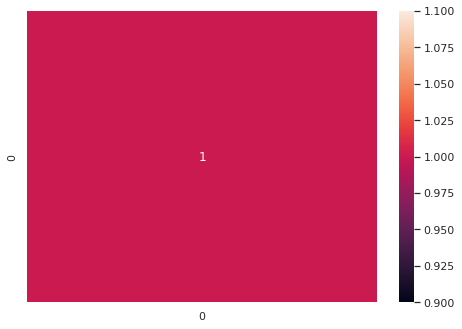



========================= IP_LINK_16 ======================




Accuracy Score:


  Accuracy:  99.72 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       0.50      0.50      0.50      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   0    0]
 [   4 1436]]


Confusion Matrix with Heat MAP:




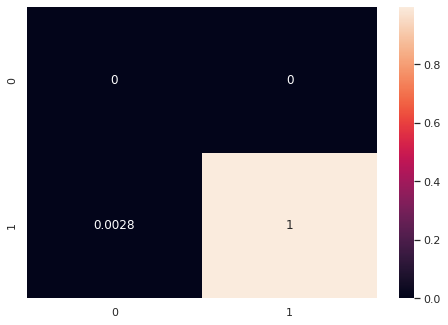



========================= IP_LINK_17 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




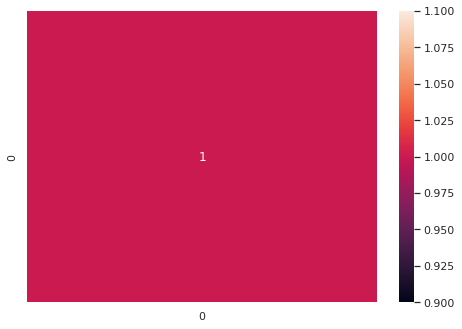



========================= IP_LINK_18 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




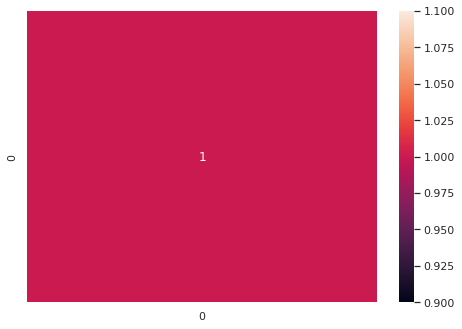



========================= IP_LINK_19 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




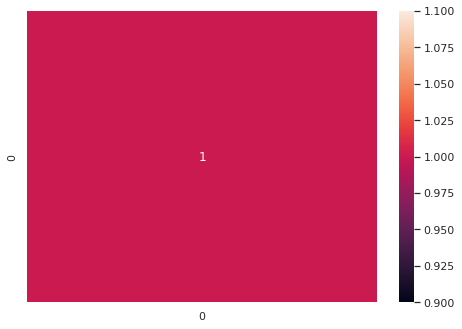



========================= IP_LINK_20 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




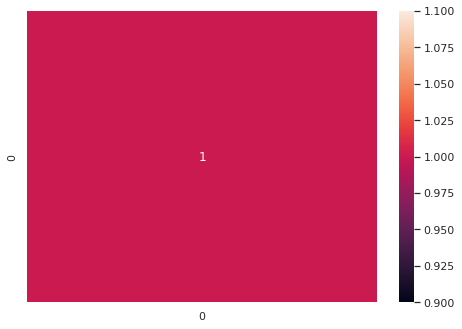



========================= IP_LINK_21 ======================




Accuracy Score:


  Accuracy:  99.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       0.50      0.50      0.50      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   0    0]
 [   2 1438]]


Confusion Matrix with Heat MAP:




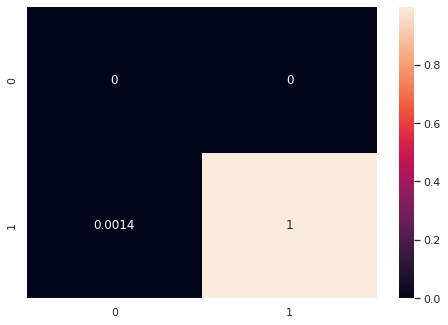



========================= IP_LINK_22 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




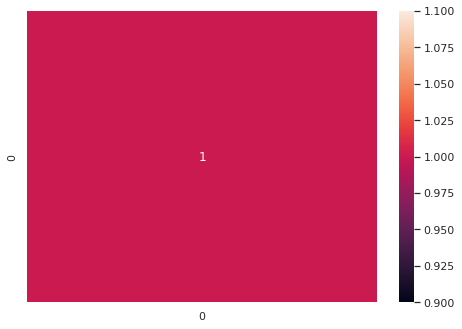



========================= IP_LINK_23 ======================




Accuracy Score:


  Accuracy:  99.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       0.50      0.50      0.50      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   0    0]
 [   1 1439]]


Confusion Matrix with Heat MAP:




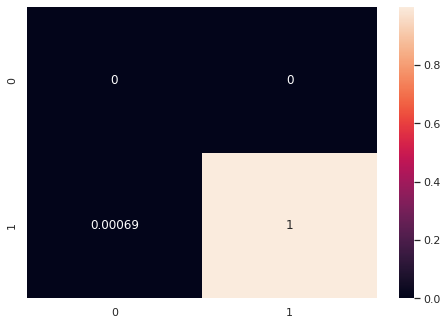



========================= IP_LINK_24 ======================




Accuracy Score:


  Accuracy:  99.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.71      1.00      0.83         5
           1       1.00      1.00      1.00      1435

    accuracy                           1.00      1440
   macro avg       0.86      1.00      0.92      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   5    0]
 [   2 1433]]


Confusion Matrix with Heat MAP:




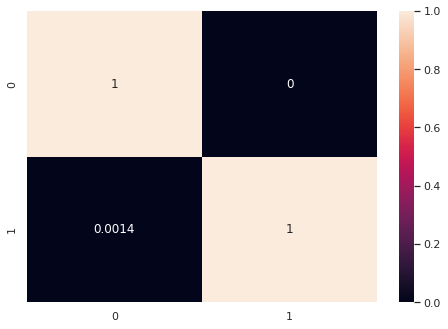



========================= IP_LINK_25 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




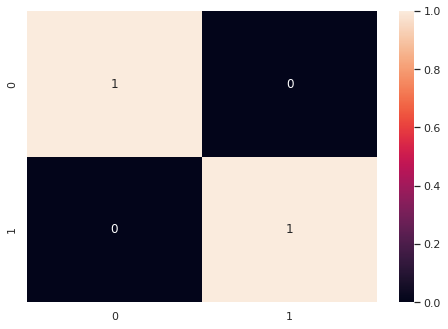



========================= IP_LINK_26 ======================




Accuracy Score:


  Accuracy:  99.79 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.25      1.00      0.40         1
           1       1.00      1.00      1.00      1439

    accuracy                           1.00      1440
   macro avg       0.62      1.00      0.70      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   1    0]
 [   3 1436]]


Confusion Matrix with Heat MAP:




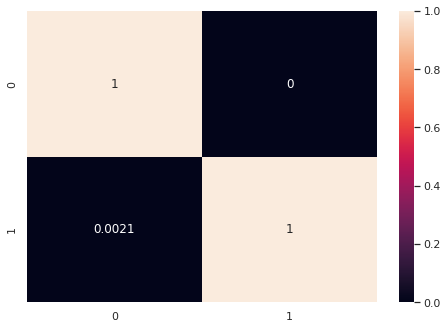



========================= IP_LINK_27 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




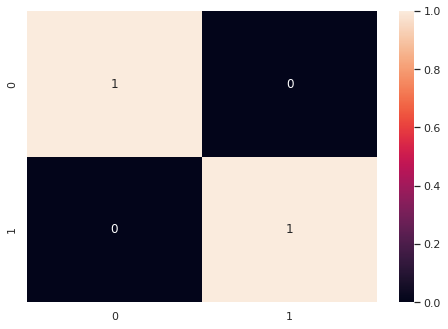



========================= IP_LINK_28 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




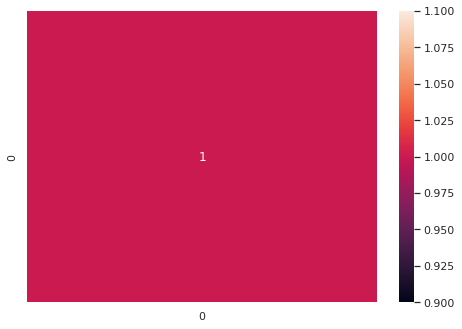



========================= IP_LINK_29 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         1
           1       1.00      1.00      1.00      1439

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   1    0]
 [   0 1439]]


Confusion Matrix with Heat MAP:




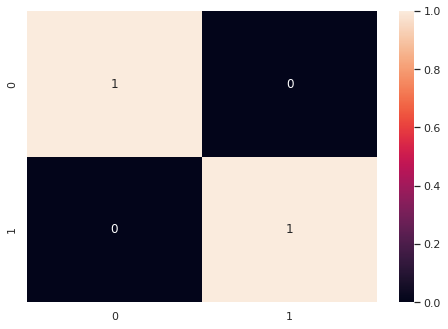



========================= IP_LINK_30 ======================




Accuracy Score:


  Accuracy:  99.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.83      1.00      0.91         5
           1       1.00      1.00      1.00      1435

    accuracy                           1.00      1440
   macro avg       0.92      1.00      0.95      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   5    0]
 [   1 1434]]


Confusion Matrix with Heat MAP:




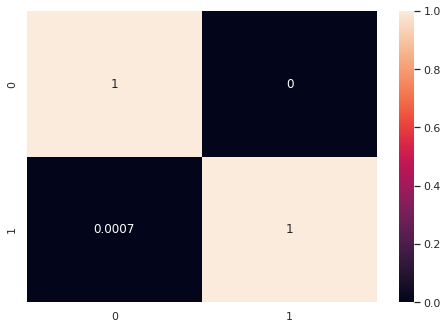

In [71]:
accuracy_3 = dict()
for i in range(30):
    
    print("\n\n ========================================================")
    print("========================= IP_LINK_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier3.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_3[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_3[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.5: One Class SVM Outlier Detection



========================= IP_LINK_1 ======================




Accuracy Score:


  Accuracy:  50.21 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         4
           1       1.00      0.50      0.67      1436

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  4   0]
 [717 719]]


Confusion Matrix with Heat MAP:




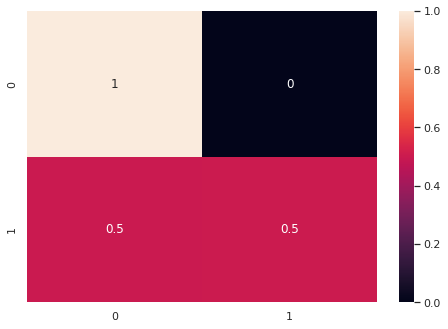



========================= IP_LINK_2 ======================




Accuracy Score:


  Accuracy:  50.56 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         7
           1       1.00      0.50      0.67      1433

    accuracy                           0.51      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.51      0.67      1440



Confusion Matrix:


[[  7   0]
 [712 721]]


Confusion Matrix with Heat MAP:




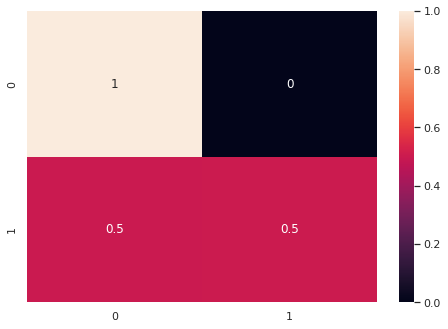



========================= IP_LINK_3 ======================




Accuracy Score:


  Accuracy:  50.35 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         3
           1       1.00      0.50      0.67      1437

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  3   0]
 [715 722]]


Confusion Matrix with Heat MAP:




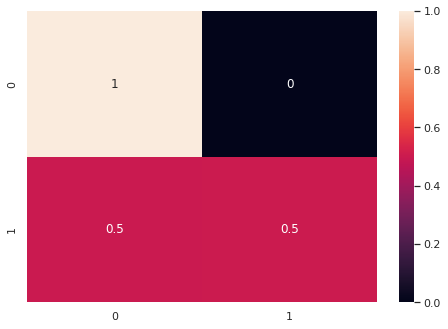



========================= IP_LINK_4 ======================




Accuracy Score:


  Accuracy:  50.28 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         4
           1       1.00      0.50      0.67      1436

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  4   0]
 [716 720]]


Confusion Matrix with Heat MAP:




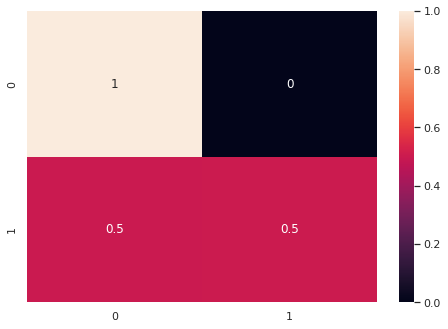



========================= IP_LINK_5 ======================




Accuracy Score:


  Accuracy:  50.14 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [718 722]]


Confusion Matrix with Heat MAP:




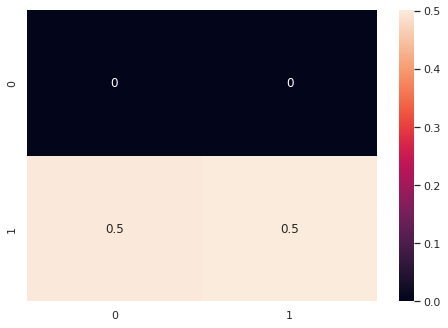



========================= IP_LINK_6 ======================




Accuracy Score:


  Accuracy:  50.28 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         2
           1       1.00      0.50      0.67      1438

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  2   0]
 [716 722]]


Confusion Matrix with Heat MAP:




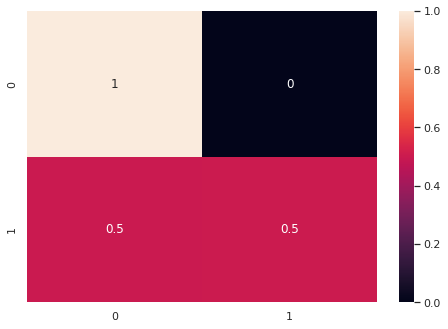



========================= IP_LINK_7 ======================




Accuracy Score:


  Accuracy:  50.35 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         6
           1       1.00      0.50      0.67      1434

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  6   0]
 [715 719]]


Confusion Matrix with Heat MAP:




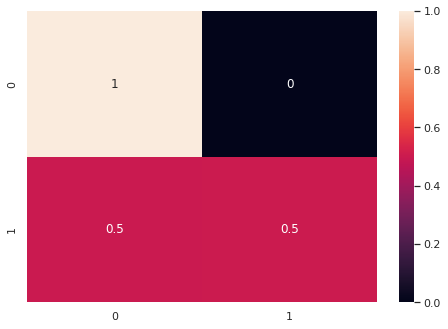



========================= IP_LINK_8 ======================




Accuracy Score:


  Accuracy:  50.49 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.02         6
           1       1.00      0.50      0.67      1434

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  6   0]
 [713 721]]


Confusion Matrix with Heat MAP:




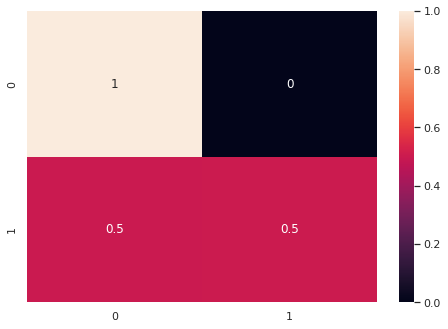



========================= IP_LINK_9 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         2
           1       1.00      0.50      0.67      1438

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  2   0]
 [720 718]]


Confusion Matrix with Heat MAP:




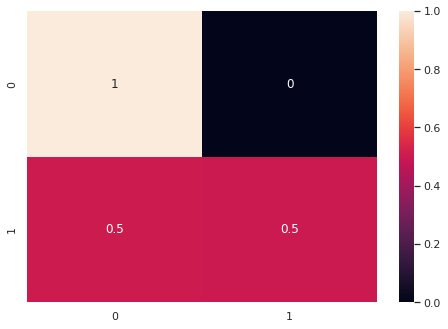



========================= IP_LINK_10 ======================




Accuracy Score:


  Accuracy:  50.28 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.01         2
           1       1.00      0.50      0.67      1438

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  2   0]
 [716 722]]


Confusion Matrix with Heat MAP:




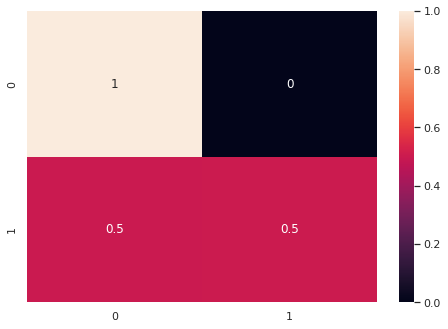



========================= IP_LINK_11 ======================




Accuracy Score:


  Accuracy:  50.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [719 721]]


Confusion Matrix with Heat MAP:




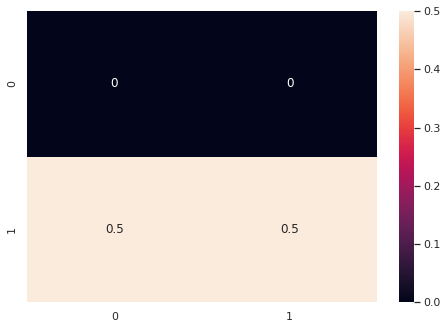



========================= IP_LINK_12 ======================




Accuracy Score:


  Accuracy:  49.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [722 718]]


Confusion Matrix with Heat MAP:




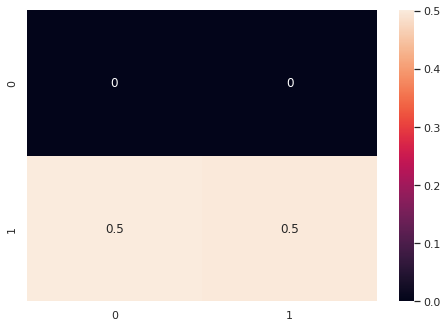



========================= IP_LINK_13 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [720 720]]


Confusion Matrix with Heat MAP:




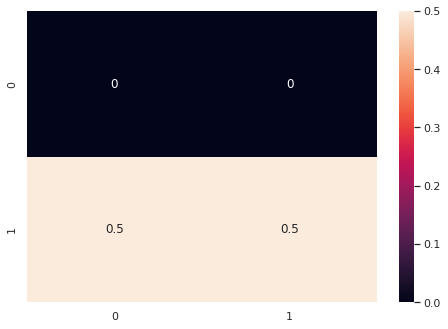



========================= IP_LINK_14 ======================




Accuracy Score:


  Accuracy:  50.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [719 721]]


Confusion Matrix with Heat MAP:




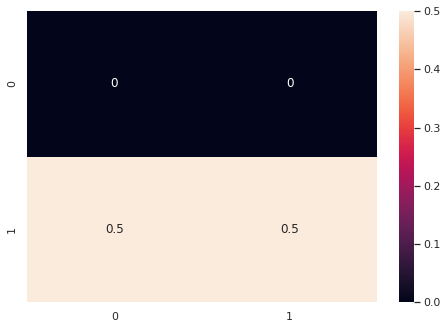



========================= IP_LINK_15 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [720 720]]


Confusion Matrix with Heat MAP:




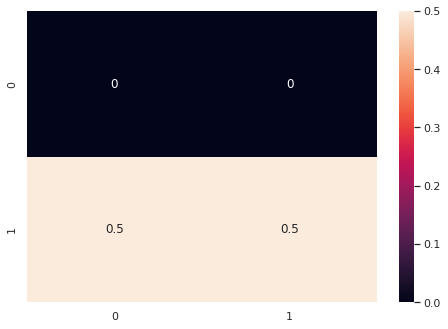



========================= IP_LINK_16 ======================




Accuracy Score:


  Accuracy:  49.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [721 719]]


Confusion Matrix with Heat MAP:




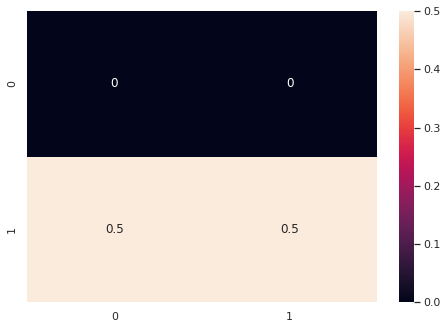



========================= IP_LINK_17 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [720 720]]


Confusion Matrix with Heat MAP:




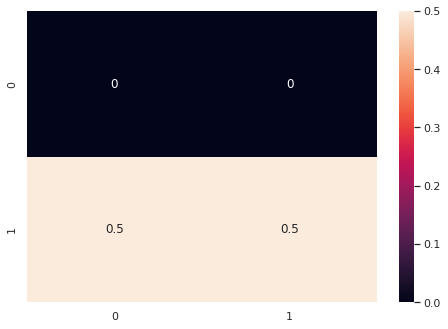



========================= IP_LINK_18 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [720 720]]


Confusion Matrix with Heat MAP:




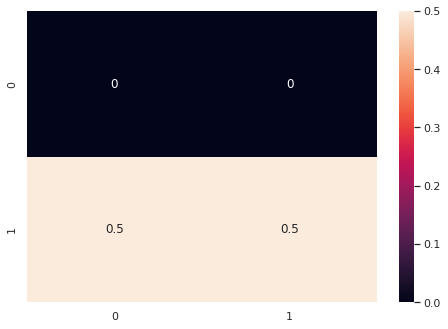



========================= IP_LINK_19 ======================




Accuracy Score:


  Accuracy:  50.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [719 721]]


Confusion Matrix with Heat MAP:




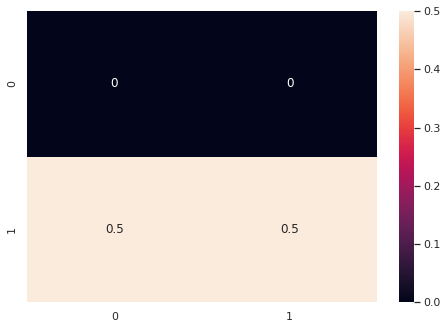



========================= IP_LINK_20 ======================




Accuracy Score:


  Accuracy:  50.21 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [717 723]]


Confusion Matrix with Heat MAP:




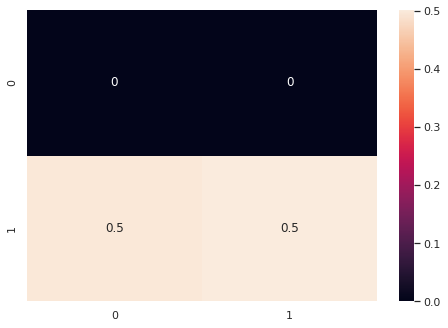



========================= IP_LINK_21 ======================




Accuracy Score:


  Accuracy:  49.86 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [722 718]]


Confusion Matrix with Heat MAP:




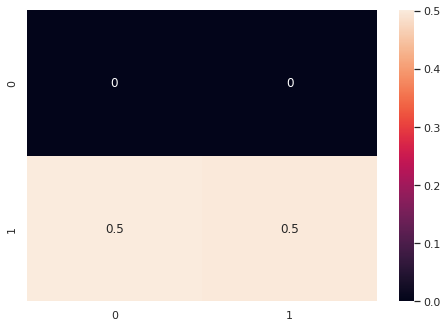



========================= IP_LINK_22 ======================




Accuracy Score:


  Accuracy:  50.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [719 721]]


Confusion Matrix with Heat MAP:




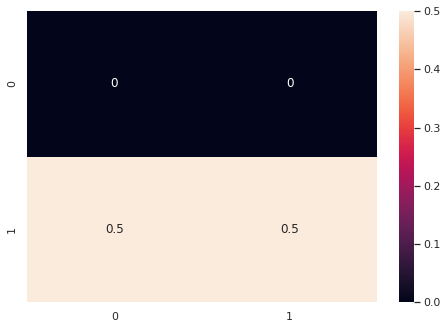



========================= IP_LINK_23 ======================




Accuracy Score:


  Accuracy:  50.07 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [719 721]]


Confusion Matrix with Heat MAP:




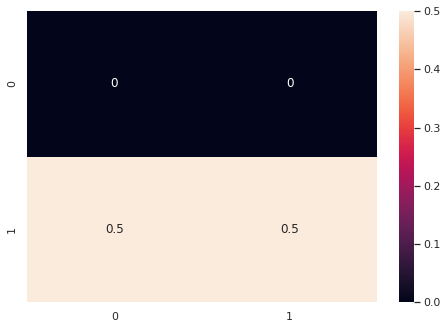



========================= IP_LINK_24 ======================




Accuracy Score:


  Accuracy:  50.35 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         5
           1       1.00      0.50      0.67      1435

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  5   0]
 [715 720]]


Confusion Matrix with Heat MAP:




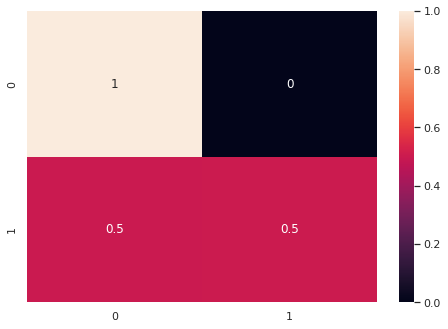



========================= IP_LINK_25 ======================




Accuracy Score:


  Accuracy:  50.14 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         4
           1       1.00      0.50      0.67      1436

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.66      1440



Confusion Matrix:


[[  4   0]
 [718 718]]


Confusion Matrix with Heat MAP:




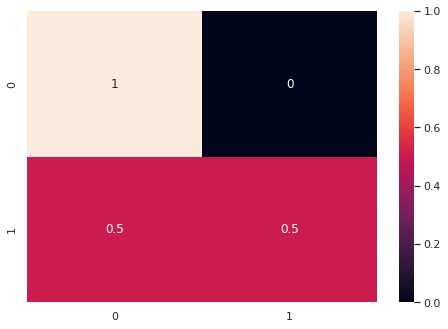



========================= IP_LINK_26 ======================




Accuracy Score:


  Accuracy:  50.21 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.00         1
           1       1.00      0.50      0.67      1439

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  1   0]
 [717 722]]


Confusion Matrix with Heat MAP:




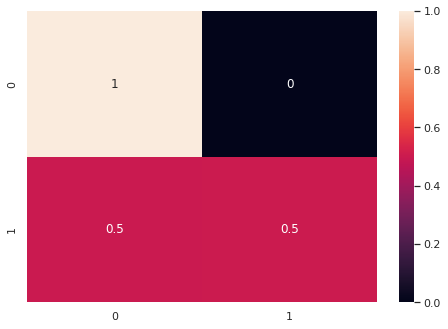



========================= IP_LINK_27 ======================




Accuracy Score:


  Accuracy:  50.35 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         4
           1       1.00      0.50      0.67      1436

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  4   0]
 [715 721]]


Confusion Matrix with Heat MAP:




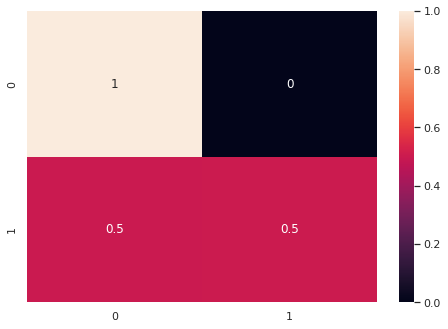



========================= IP_LINK_28 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      0.50      0.67      1440

    accuracy                           0.50      1440
   macro avg       0.50      0.25      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  0   0]
 [720 720]]


Confusion Matrix with Heat MAP:




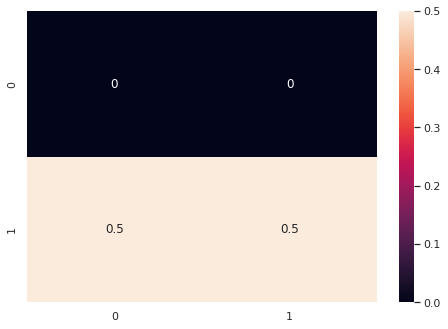



========================= IP_LINK_29 ======================




Accuracy Score:


  Accuracy:  50.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      1.00      0.00         1
           1       1.00      0.50      0.67      1439

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.33      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  1   0]
 [720 719]]


Confusion Matrix with Heat MAP:




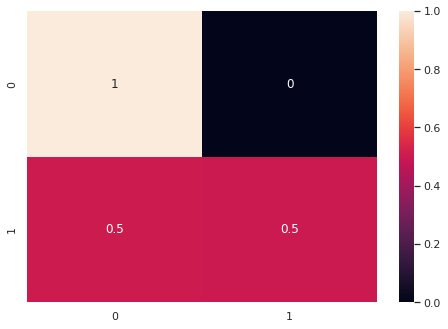



========================= IP_LINK_30 ======================




Accuracy Score:


  Accuracy:  50.42 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.01      1.00      0.01         5
           1       1.00      0.50      0.67      1435

    accuracy                           0.50      1440
   macro avg       0.50      0.75      0.34      1440
weighted avg       1.00      0.50      0.67      1440



Confusion Matrix:


[[  5   0]
 [714 721]]


Confusion Matrix with Heat MAP:




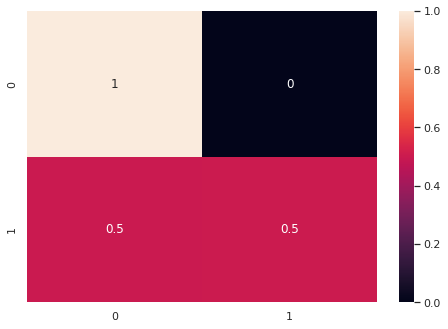

In [72]:
accuracy_4 = dict()
for i in range(30):
    
    print("\n\n ========================================================")
    print("========================= IP_LINK_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier4.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_4[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_4[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

## Step 6.6: DBSCAN Outlier Detection



========================= IP_LINK_1 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




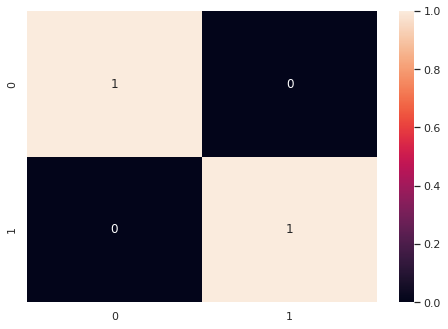



========================= IP_LINK_2 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         7
           1       1.00      1.00      1.00      1433

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   7    0]
 [   0 1433]]


Confusion Matrix with Heat MAP:




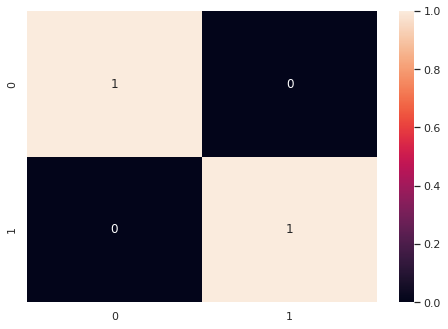



========================= IP_LINK_3 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         3
           1       1.00      1.00      1.00      1437

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   3    0]
 [   0 1437]]


Confusion Matrix with Heat MAP:




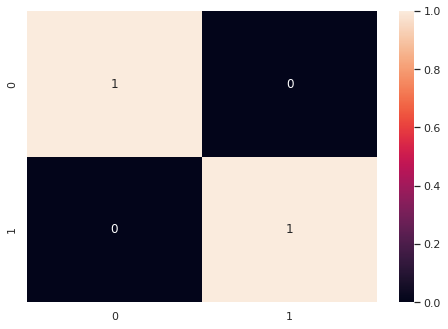



========================= IP_LINK_4 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




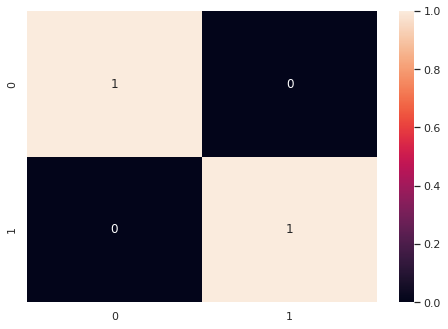



========================= IP_LINK_5 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




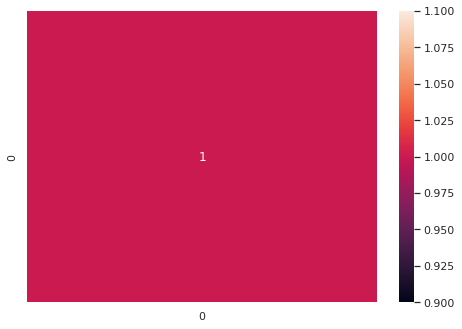



========================= IP_LINK_6 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         2
           1       1.00      1.00      1.00      1438

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   2    0]
 [   0 1438]]


Confusion Matrix with Heat MAP:




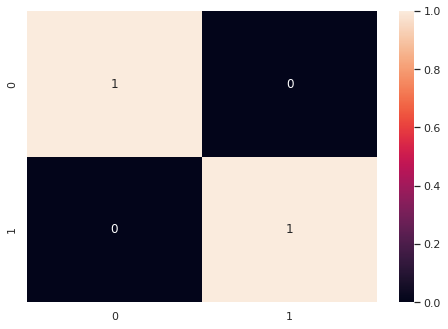



========================= IP_LINK_7 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         6
           1       1.00      1.00      1.00      1434

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   6    0]
 [   0 1434]]


Confusion Matrix with Heat MAP:




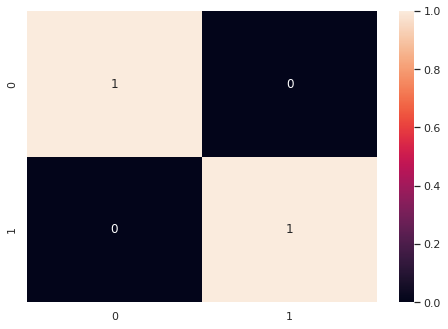



========================= IP_LINK_8 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         6
           1       1.00      1.00      1.00      1434

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   6    0]
 [   0 1434]]


Confusion Matrix with Heat MAP:




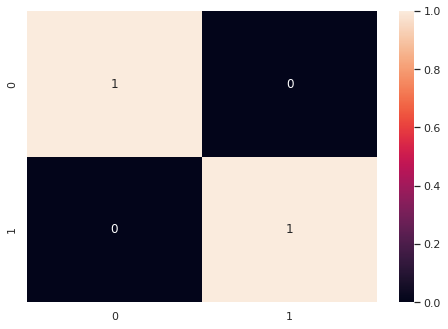



========================= IP_LINK_9 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         2
           1       1.00      1.00      1.00      1438

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   2    0]
 [   0 1438]]


Confusion Matrix with Heat MAP:




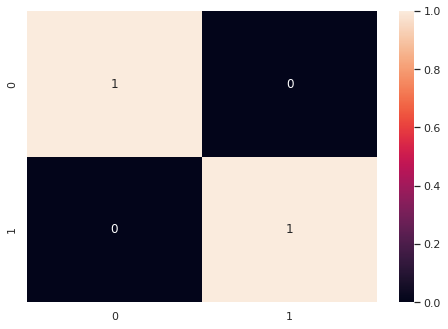



========================= IP_LINK_10 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         2
           1       1.00      1.00      1.00      1438

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   2    0]
 [   0 1438]]


Confusion Matrix with Heat MAP:




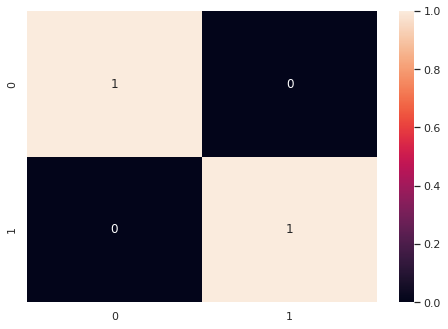



========================= IP_LINK_11 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




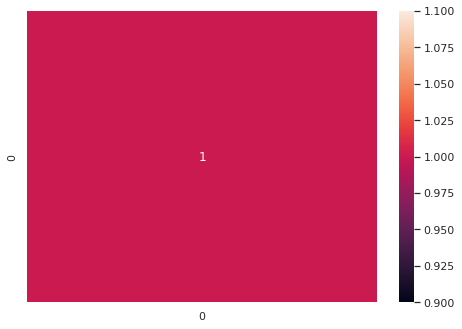



========================= IP_LINK_12 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




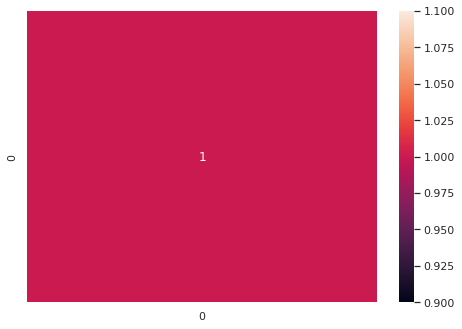



========================= IP_LINK_13 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




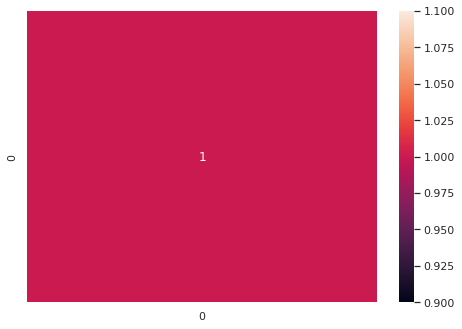



========================= IP_LINK_14 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




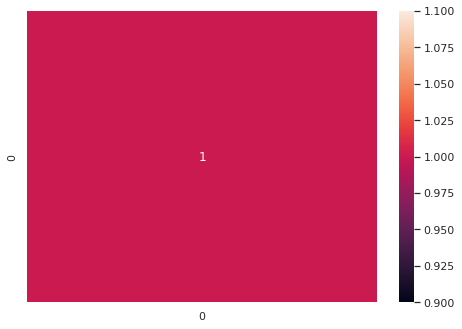



========================= IP_LINK_15 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




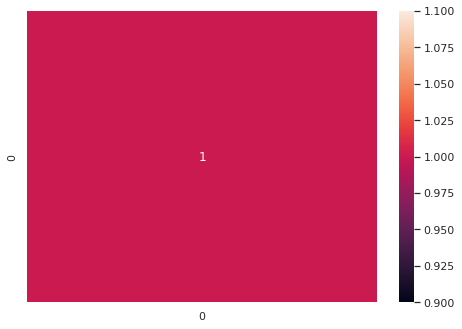



========================= IP_LINK_16 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




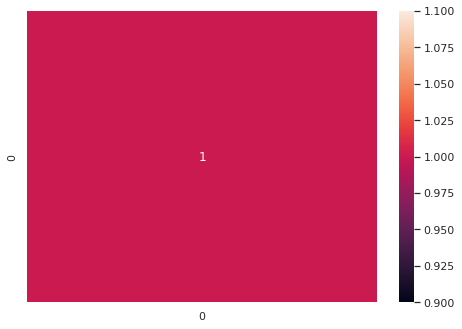



========================= IP_LINK_17 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




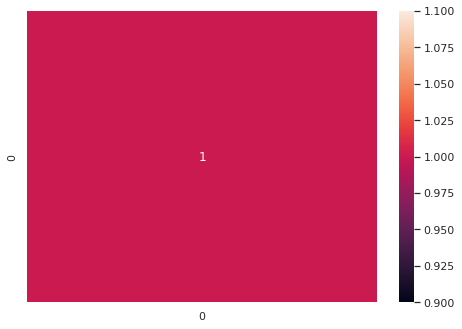



========================= IP_LINK_18 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




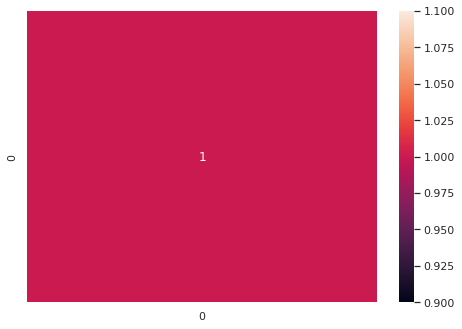



========================= IP_LINK_19 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




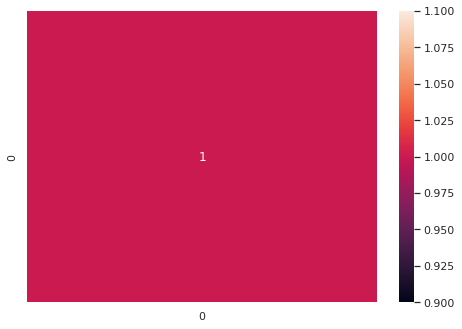



========================= IP_LINK_20 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




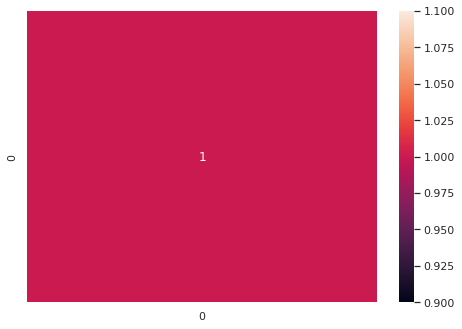



========================= IP_LINK_21 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




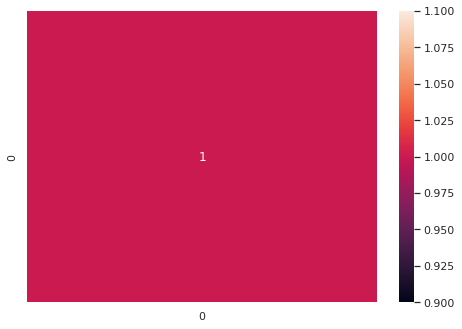



========================= IP_LINK_22 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




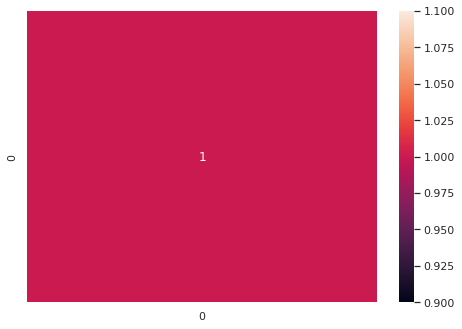



========================= IP_LINK_23 ======================




Accuracy Score:


  Accuracy:  99.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.00      0.00      0.00         0
           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       0.50      0.50      0.50      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   0    0]
 [   1 1439]]


Confusion Matrix with Heat MAP:




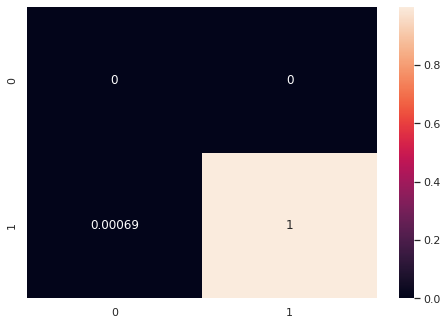



========================= IP_LINK_24 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         5
           1       1.00      1.00      1.00      1435

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   5    0]
 [   0 1435]]


Confusion Matrix with Heat MAP:




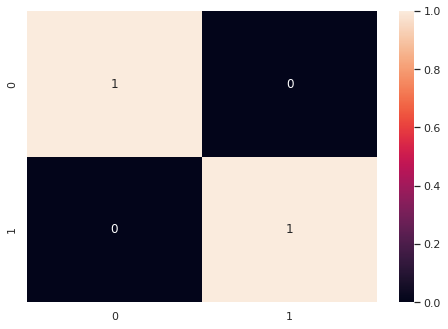



========================= IP_LINK_25 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




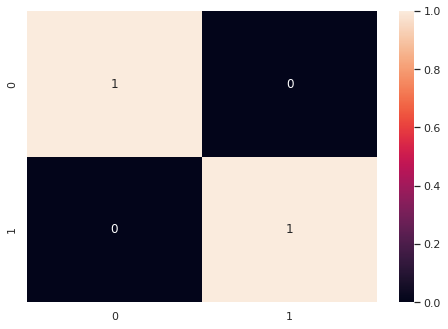



========================= IP_LINK_26 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         1
           1       1.00      1.00      1.00      1439

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   1    0]
 [   0 1439]]


Confusion Matrix with Heat MAP:




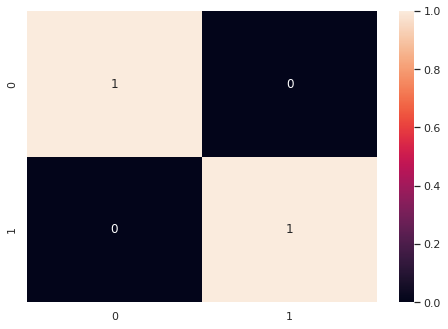



========================= IP_LINK_27 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         4
           1       1.00      1.00      1.00      1436

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   4    0]
 [   0 1436]]


Confusion Matrix with Heat MAP:




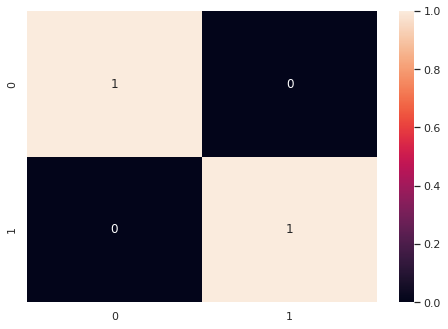



========================= IP_LINK_28 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

           1       1.00      1.00      1.00      1440

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[1440]]


Confusion Matrix with Heat MAP:




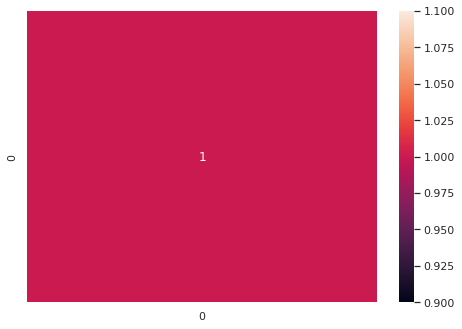



========================= IP_LINK_29 ======================




Accuracy Score:


  Accuracy:  100.0 %


Classification Report:


              precision    recall  f1-score   support

          -1       1.00      1.00      1.00         1
           1       1.00      1.00      1.00      1439

    accuracy                           1.00      1440
   macro avg       1.00      1.00      1.00      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   1    0]
 [   0 1439]]


Confusion Matrix with Heat MAP:




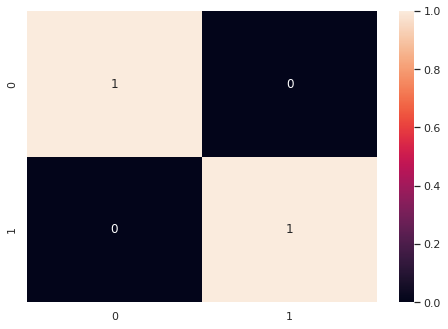



========================= IP_LINK_30 ======================




Accuracy Score:


  Accuracy:  99.93 %


Classification Report:


              precision    recall  f1-score   support

          -1       0.83      1.00      0.91         5
           1       1.00      1.00      1.00      1435

    accuracy                           1.00      1440
   macro avg       0.92      1.00      0.95      1440
weighted avg       1.00      1.00      1.00      1440



Confusion Matrix:


[[   5    0]
 [   1 1434]]


Confusion Matrix with Heat MAP:




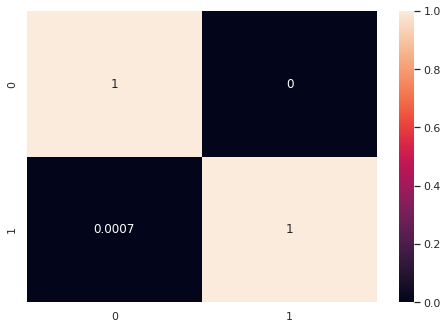

In [73]:
accuracy_5 = dict()
for i in range(30):
    
    print("\n\n ========================================================")
    print("========================= IP_LINK_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    # Evalution
    y_test = X_test.loc[i].to_numpy().flatten()
    y_pred = outlier5.loc[i].to_numpy().flatten()

    # Accuracy Score
    accuracy_5[i] = accuracy_score(y_test, y_pred)
    print("\n\n======================")
    print("Accuracy Score:")
    print("======================\n\n")
    print("  Accuracy: ", round(accuracy_5[i]*100,2), "%")

    # Classification Report
    report = classification_report(y_test, y_pred)
    print("\n\n======================")
    print("Classification Report:")
    print("======================\n\n")
    print(report)

    # Confusion Matrix
    matrix = confusion_matrix(y_test, y_pred)
    print("\n\n=================")
    print("Confusion Matrix:")
    print("=================\n\n")
    print(matrix)

    # Heat Map
    print("\n\n===============================")
    print("Confusion Matrix with Heat MAP:")
    print("===============================\n\n")
    confusion_matrix_heatmap = confusion_matrix(y_test, y_pred, normalize = 'true')
    sns.set(rc={'figure.figsize':(7,5)})
    sns.heatmap(confusion_matrix_heatmap, annot=True)
    plt.show()

# Step 7: Comparison of all Models



========================= IP_LINK_1 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    70.42 %     |
|     Autoencoder      |    90.62 %     |
| Local Outlier Factor |    99.93 %     |
|    One Class SVM     |    50.21 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


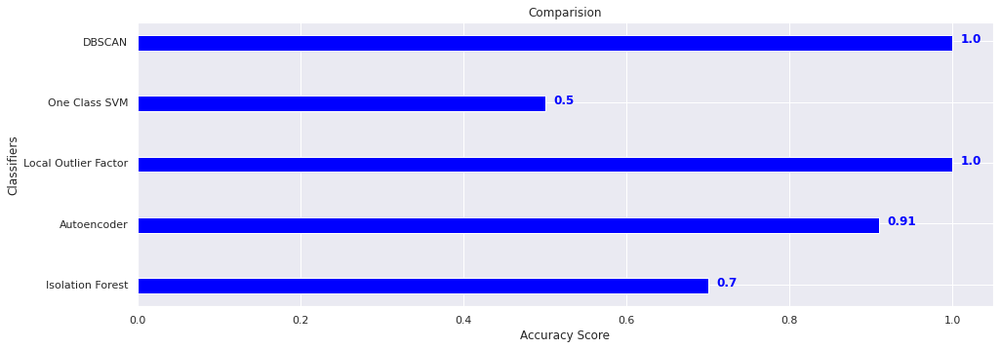



========================= IP_LINK_2 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    83.47 %     |
|     Autoencoder      |    100.0 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.56 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


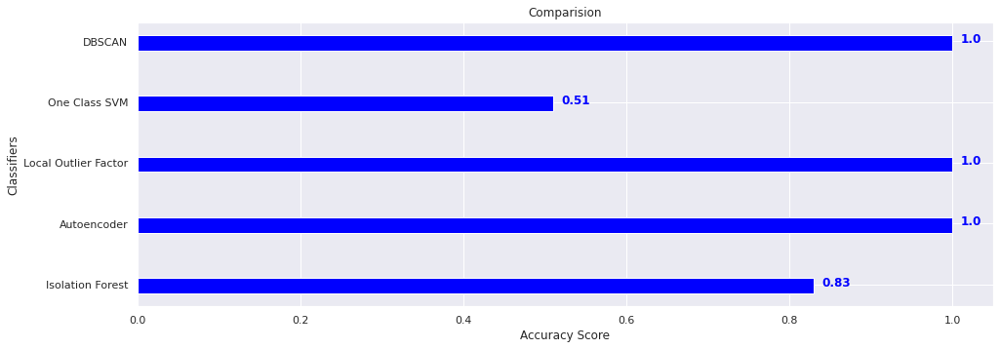



========================= IP_LINK_3 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    63.12 %     |
|     Autoencoder      |    100.0 %     |
| Local Outlier Factor |    99.86 %     |
|    One Class SVM     |    50.35 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


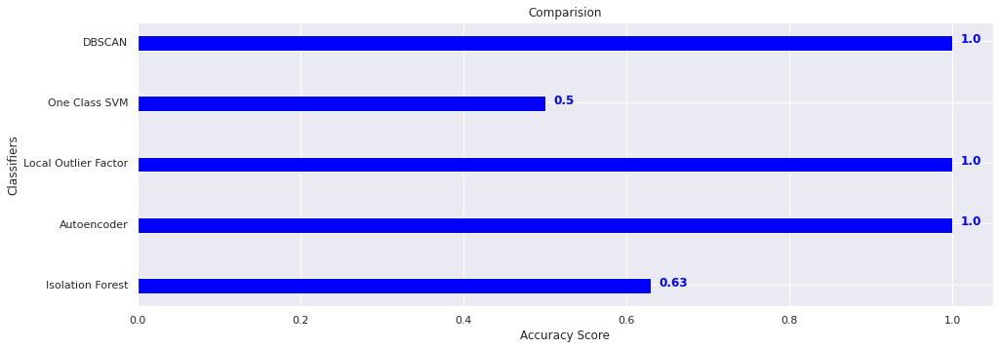



========================= IP_LINK_4 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    73.47 %     |
|     Autoencoder      |    91.11 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.28 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


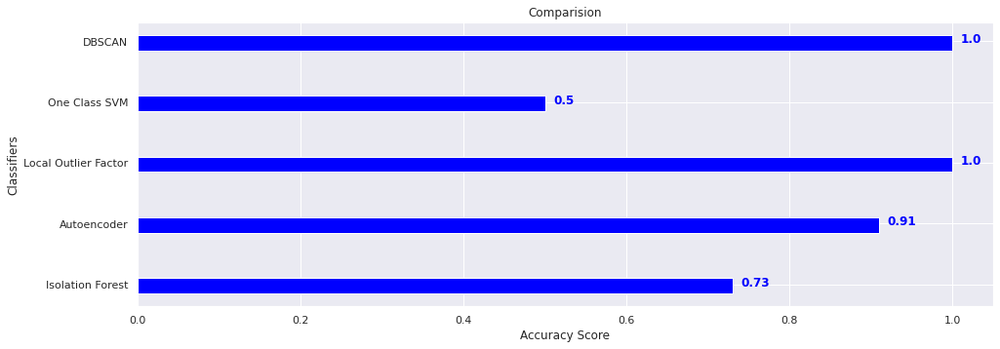



========================= IP_LINK_5 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    53.89 %     |
|     Autoencoder      |    77.71 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.14 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


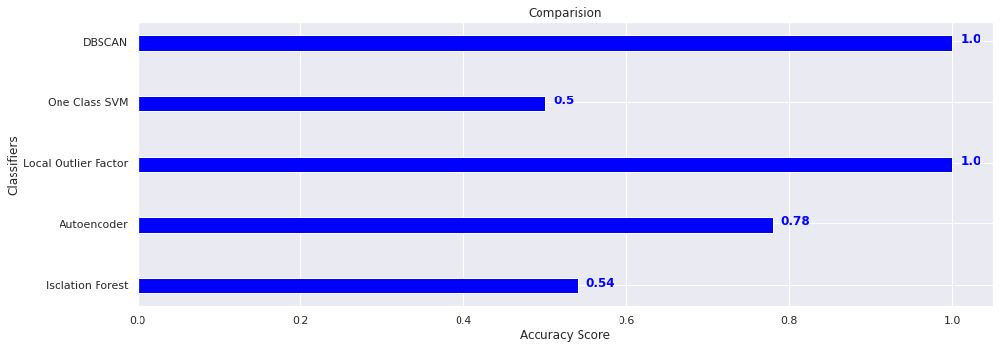



========================= IP_LINK_6 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     67.5 %     |
|     Autoencoder      |    83.54 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.28 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


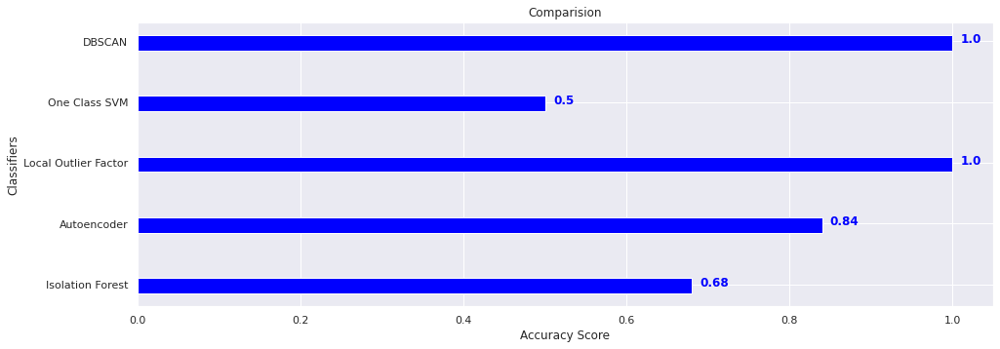



========================= IP_LINK_7 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    78.68 %     |
|     Autoencoder      |     85.9 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.35 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


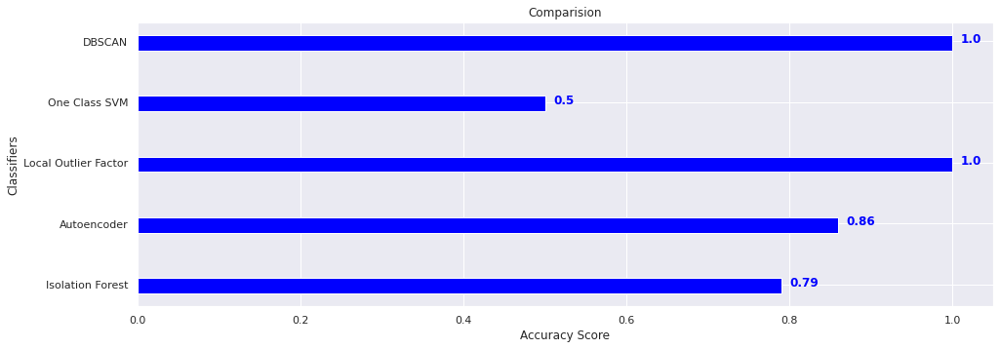



========================= IP_LINK_8 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     79.1 %     |
|     Autoencoder      |    87.78 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.49 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


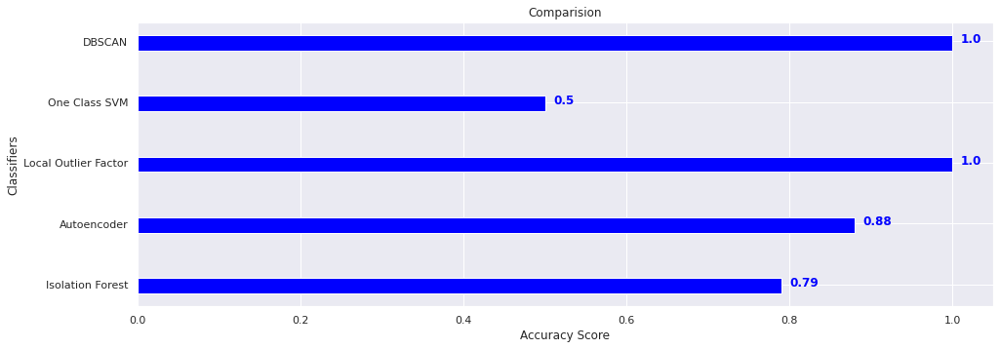



========================= IP_LINK_9 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    55.21 %     |
|     Autoencoder      |    98.75 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


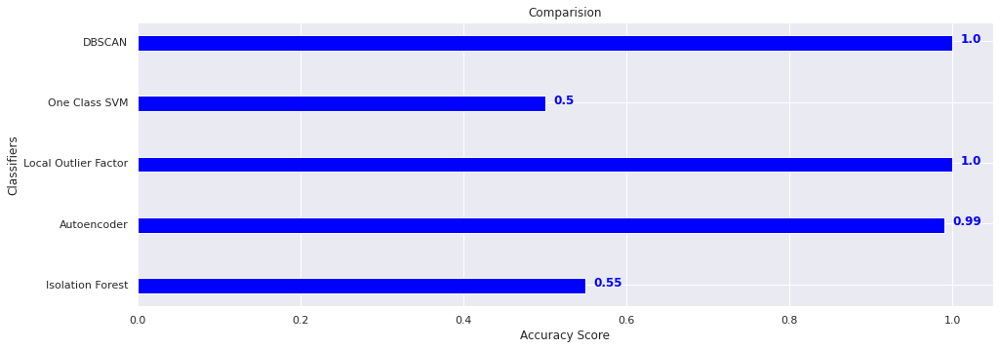



========================= IP_LINK_10 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    51.94 %     |
|     Autoencoder      |    80.76 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.28 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


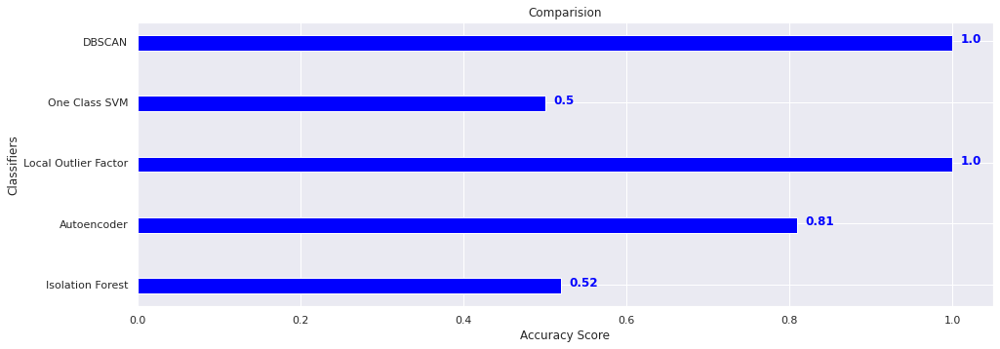



========================= IP_LINK_11 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    41.39 %     |
|     Autoencoder      |    80.69 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.07 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


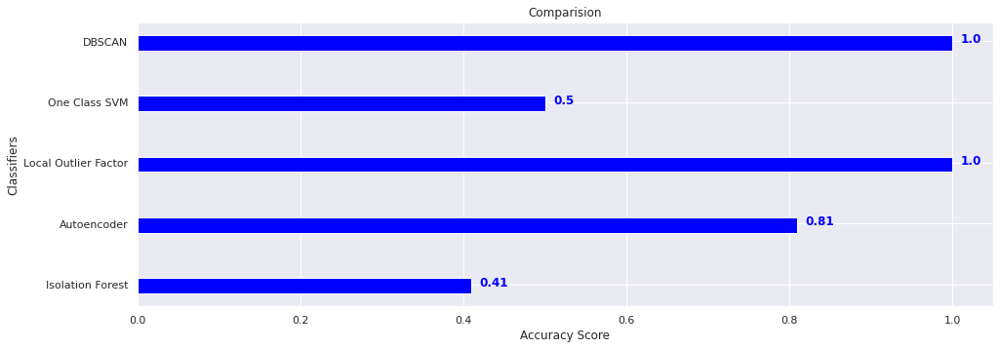



========================= IP_LINK_12 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    41.04 %     |
|     Autoencoder      |    78.47 %     |
| Local Outlier Factor |    99.44 %     |
|    One Class SVM     |    49.86 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


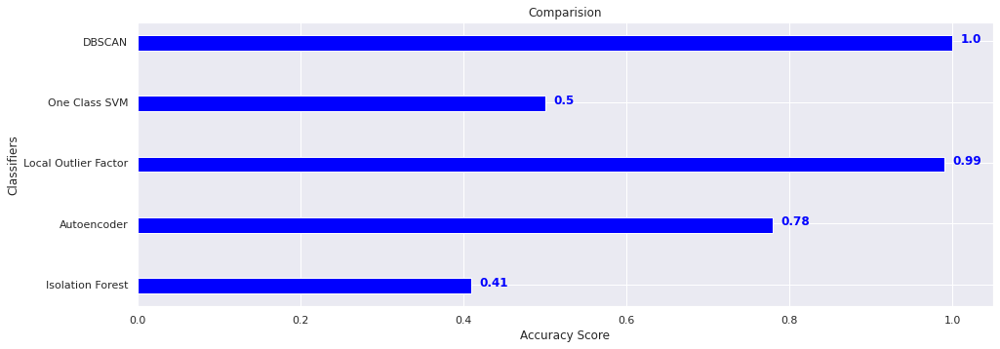



========================= IP_LINK_13 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    48.82 %     |
|     Autoencoder      |    79.58 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


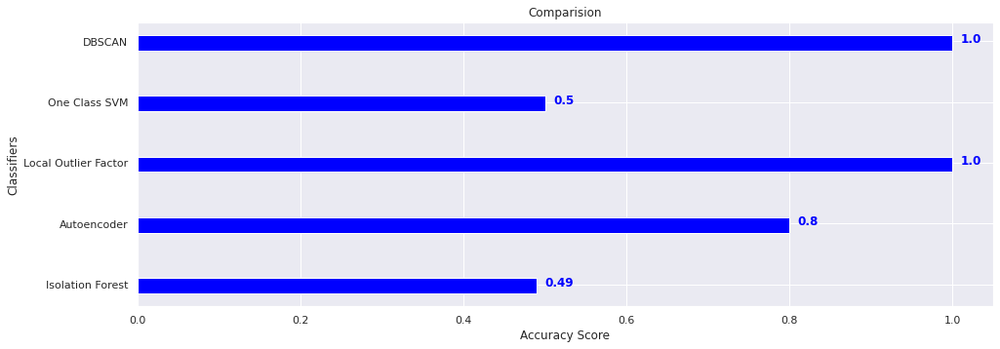



========================= IP_LINK_14 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     38.4 %     |
|     Autoencoder      |    79.44 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.07 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


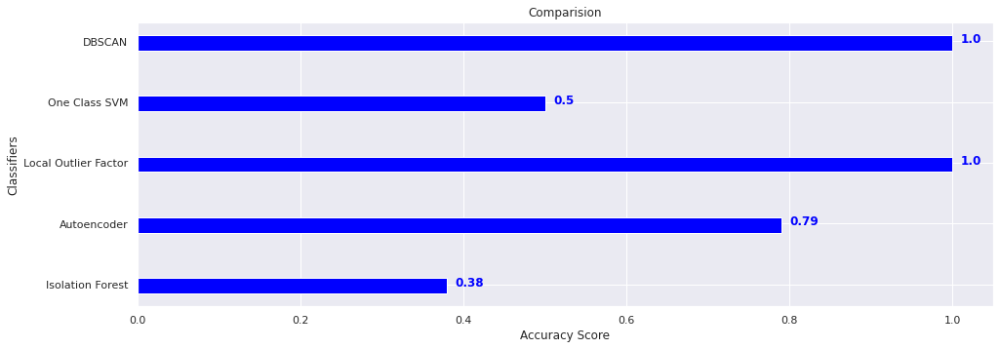



========================= IP_LINK_15 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    54.31 %     |
|     Autoencoder      |     81.6 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


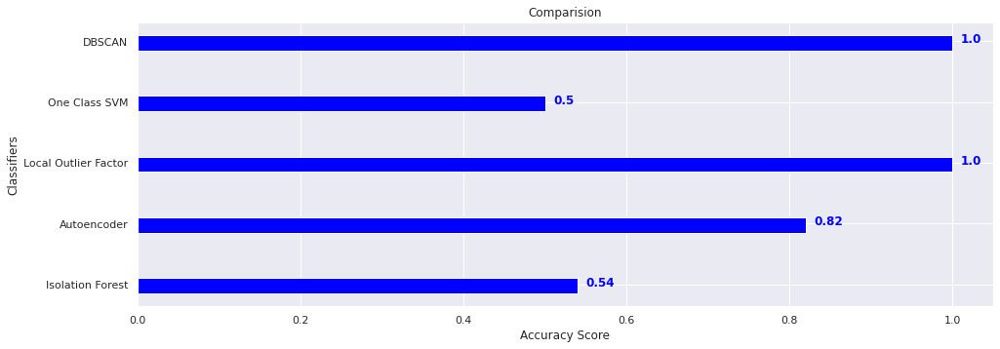



========================= IP_LINK_16 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    38.33 %     |
|     Autoencoder      |    78.33 %     |
| Local Outlier Factor |    99.72 %     |
|    One Class SVM     |    49.93 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


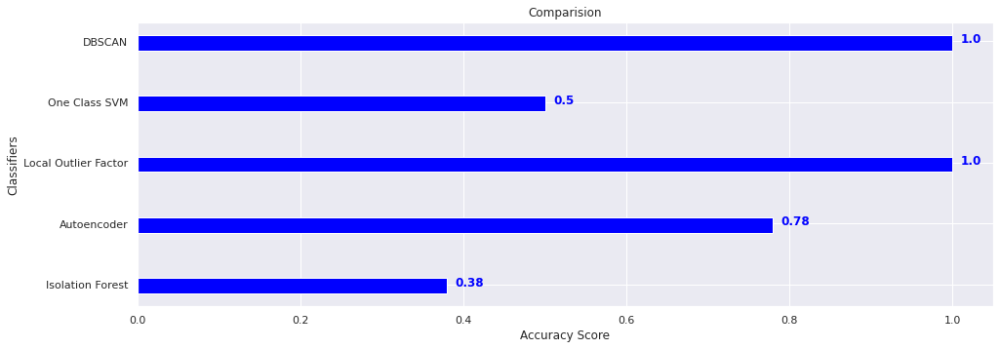



========================= IP_LINK_17 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    34.17 %     |
|     Autoencoder      |    79.31 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


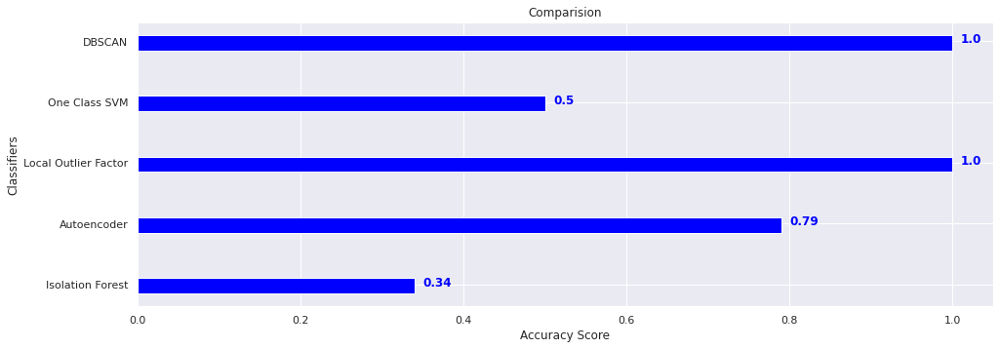



========================= IP_LINK_18 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    42.64 %     |
|     Autoencoder      |    81.11 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


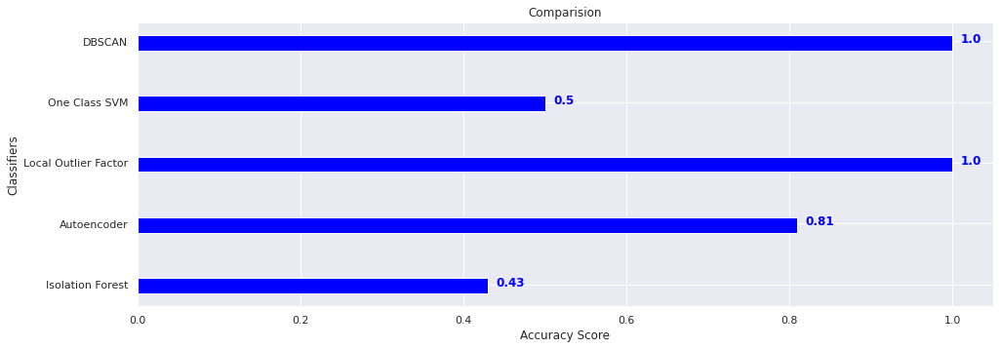



========================= IP_LINK_19 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    47.29 %     |
|     Autoencoder      |    79.24 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.07 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


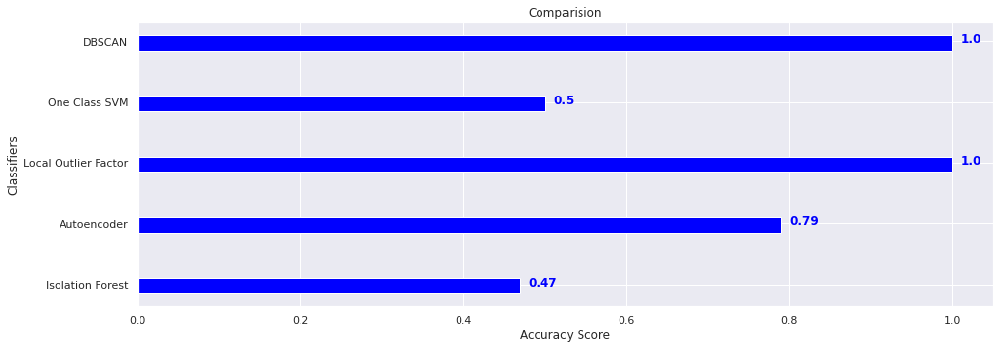



========================= IP_LINK_20 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    45.42 %     |
|     Autoencoder      |    80.35 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.21 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


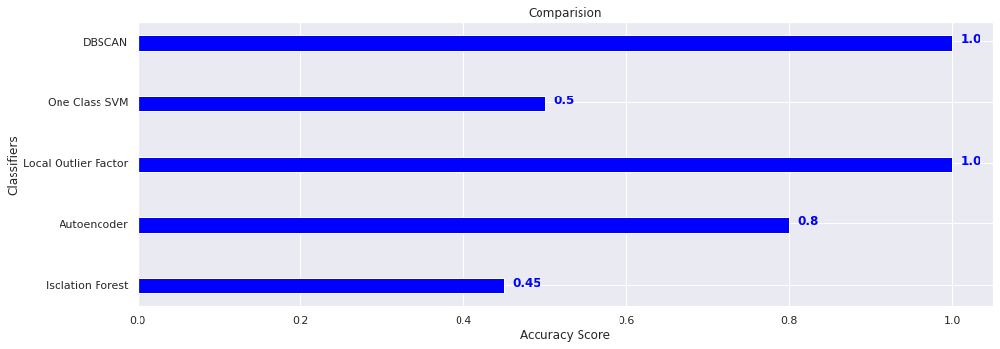



========================= IP_LINK_21 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     44.1 %     |
|     Autoencoder      |     81.6 %     |
| Local Outlier Factor |    99.86 %     |
|    One Class SVM     |    49.86 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


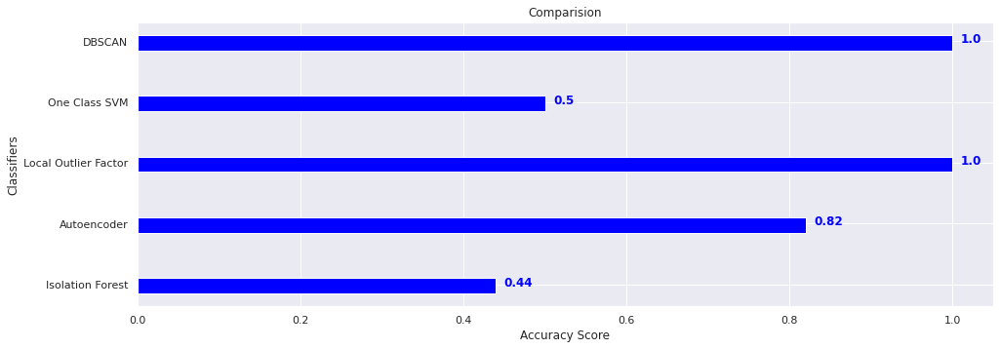



========================= IP_LINK_22 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |     45.0 %     |
|     Autoencoder      |    80.76 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.07 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


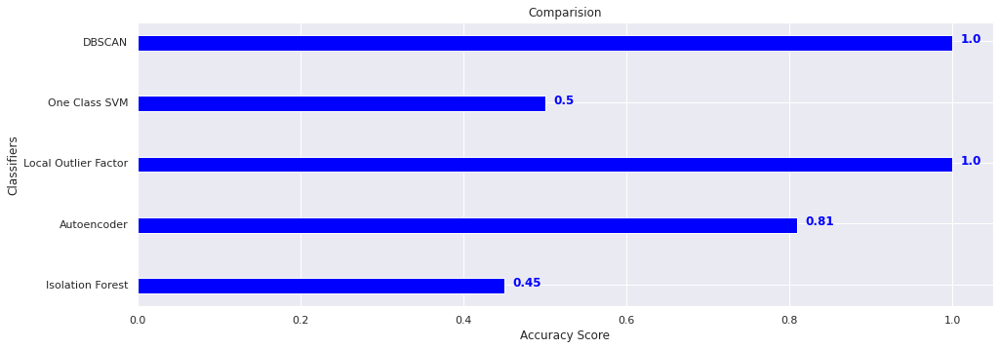



========================= IP_LINK_23 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    42.15 %     |
|     Autoencoder      |    79.93 %     |
| Local Outlier Factor |    99.93 %     |
|    One Class SVM     |    50.07 %     |
|        DBSCAN        |    99.93 %     |
+----------------------+----------------+


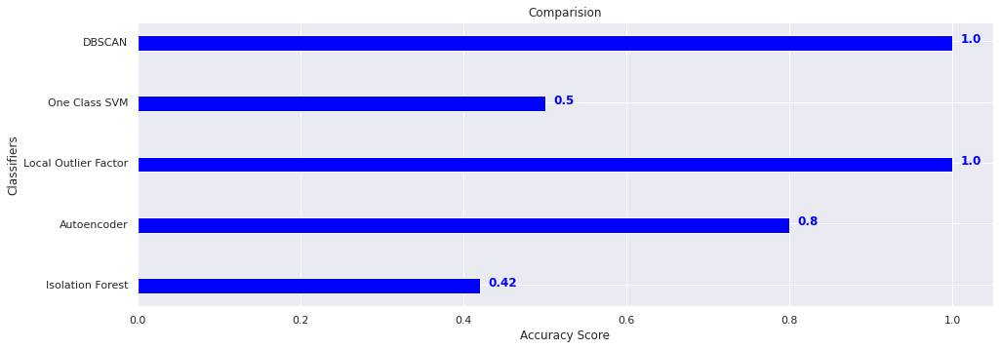



========================= IP_LINK_24 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    79.51 %     |
|     Autoencoder      |    90.35 %     |
| Local Outlier Factor |    99.86 %     |
|    One Class SVM     |    50.35 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


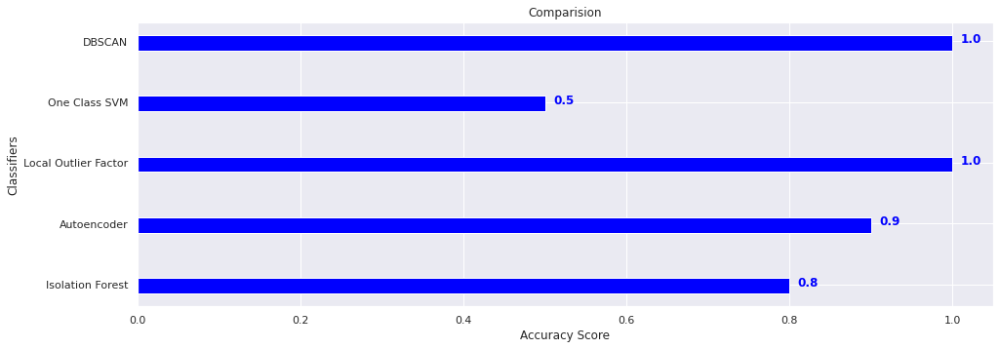



========================= IP_LINK_25 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    80.07 %     |
|     Autoencoder      |    99.65 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.14 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


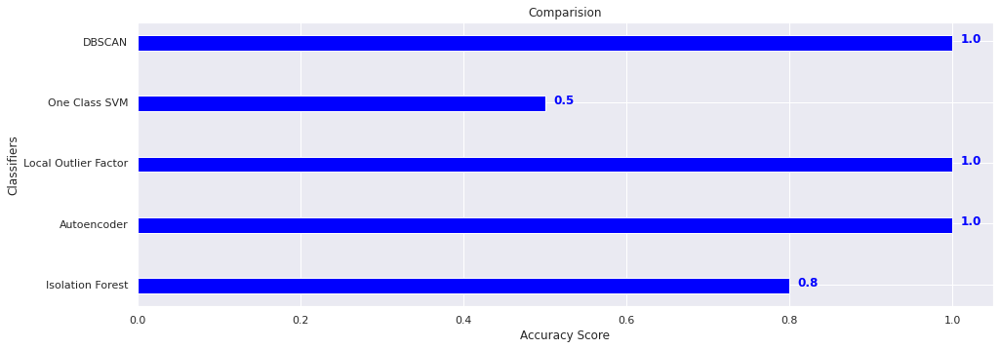



========================= IP_LINK_26 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    57.43 %     |
|     Autoencoder      |    80.69 %     |
| Local Outlier Factor |    99.79 %     |
|    One Class SVM     |    50.21 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


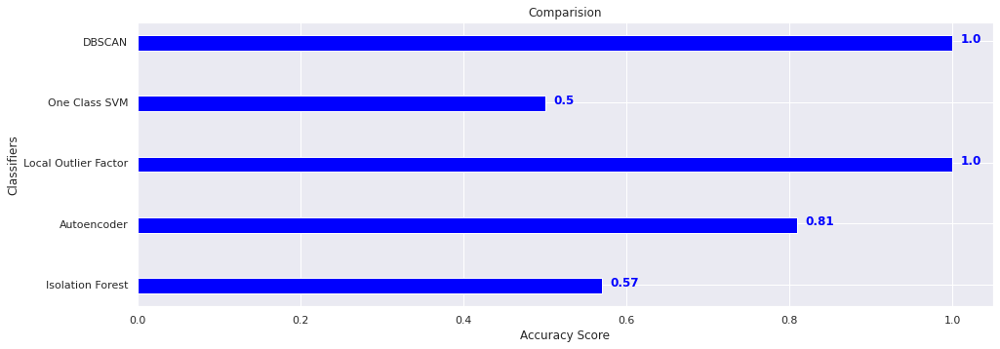



========================= IP_LINK_27 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    75.07 %     |
|     Autoencoder      |    85.49 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |    50.35 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


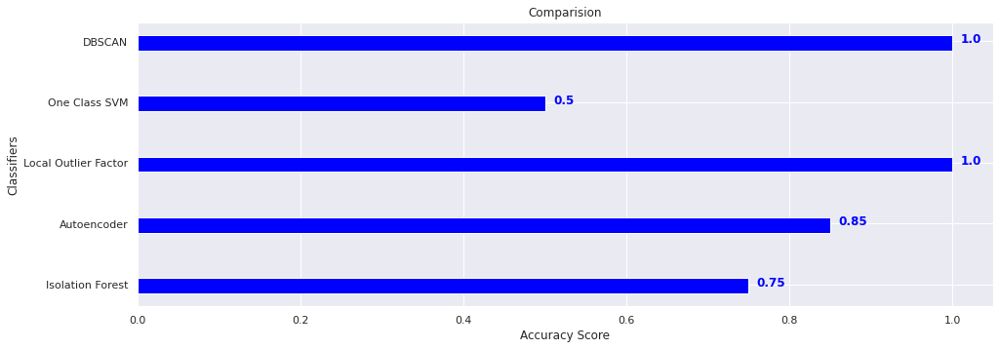



========================= IP_LINK_28 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    35.42 %     |
|     Autoencoder      |    79.44 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


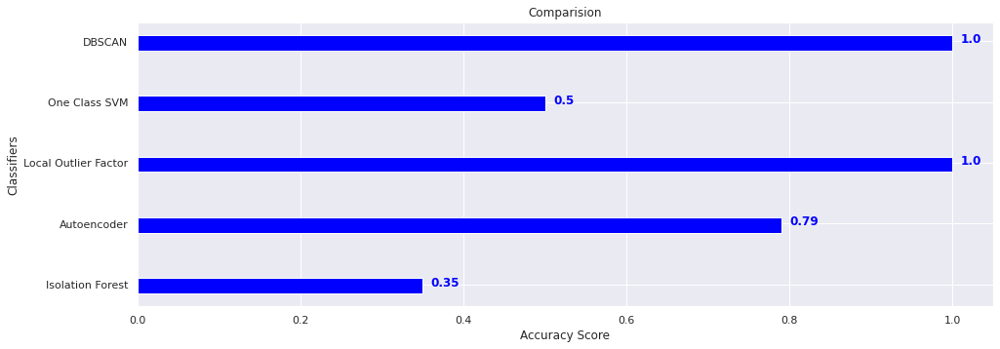



========================= IP_LINK_29 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    52.57 %     |
|     Autoencoder      |    80.83 %     |
| Local Outlier Factor |    100.0 %     |
|    One Class SVM     |     50.0 %     |
|        DBSCAN        |    100.0 %     |
+----------------------+----------------+


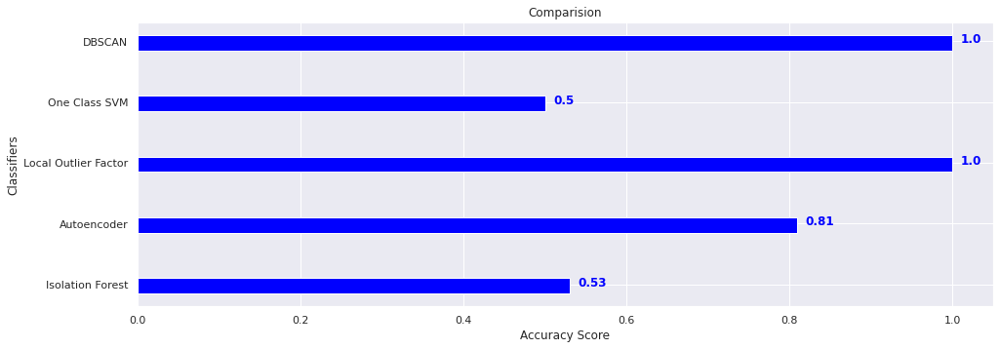



========================= IP_LINK_30 ======================



Performance with Models

+----------------------+----------------+
|   Classifier Name    | Accuracy Score |
+----------------------+----------------+
|   Isolation Forest   |    81.46 %     |
|     Autoencoder      |    86.11 %     |
| Local Outlier Factor |    99.93 %     |
|    One Class SVM     |    50.42 %     |
|        DBSCAN        |    99.93 %     |
+----------------------+----------------+


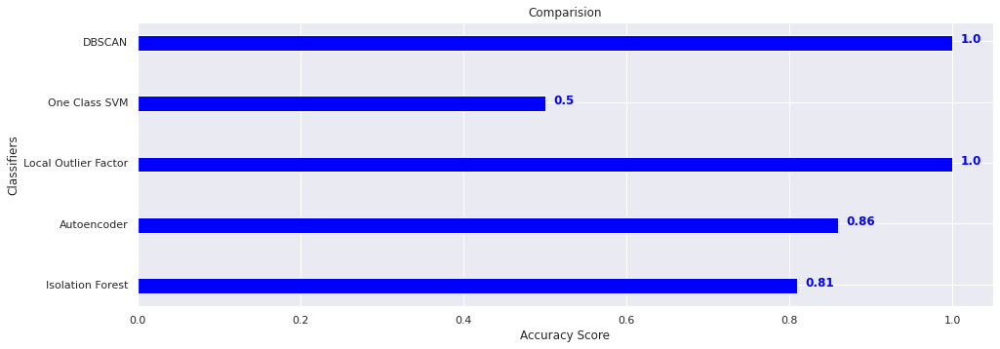

In [74]:
for i in range(30):
    
    print("\n\n ========================================================")
    print("========================= IP_LINK_" + str(i+1) + " ======================")
    print(" ========================================================\n\n")
    
    print("\nPerformance with Models")
    print("=======================\n")
    x=PrettyTable()
    x.add_column("Classifier Name",["Isolation Forest","Autoencoder","Local Outlier Factor", "One Class SVM", "DBSCAN"])
    x.add_column("Accuracy Score",[str(round(accuracy_1[i]*100,2)) + " %", str(round(accuracy_2[i]*100,2)) + " %", str(round(accuracy_3[i]*100,2)) + " %", str(round(accuracy_4[i]*100,2)) + " %", str(round(accuracy_5[i]*100,2)) + " %"])
    print(x)

    x = ["Isolation Forest","Autoencoder","Local Outlier Factor", "One Class SVM", "DBSCAN"]
    y = [round(accuracy_1[i],2), round(accuracy_2[i],2), round(accuracy_3[i],2), round(accuracy_4[i],2), round(accuracy_5[i],2)]

    plt.rcParams["figure.figsize"] = (14,5)
    fig, ax = plt.subplots() 
    width = 0.25
    ind = np.arange(len(y))
    ax.barh(ind, y, width, color="blue")
    ax.set_yticks((ind+width/2)-0.1)
    ax.set_yticklabels(x, minor=False)
    for i, v in enumerate(y):
        ax.text(v + 0.01, i , str(v), color='blue', fontweight='bold')
    plt.title('Comparision')
    plt.xlabel('Accuracy Score')
    plt.ylabel('Classifiers')      
    plt.show()